# Active learning Methods

In [ ]:
pip install -q graphlearning

In [ ]:
import graphlearning as gl
import numpy as np
from scipy import sparse, linalg
from scipy.special import softmax
import matplotlib
import matplotlib.pyplot as plt

In [ ]:
#Function to generate the weight matrix
def weight_matrix(data):
  boolean = False
  k=1
  I,J,D = gl.knnsearch_annoy(data, 50)
  D[D==0] = 1e-150

  while boolean==False:
    k+=1
    W = gl.weight_matrix(I,J,D,k)
    boolean = gl.isconnected(W)
    print("k=%d"%k, "connected=%s"%boolean)

  k=2*k
  W = gl.weight_matrix(I,J,D,k)
  print("k=%d"%k, "connected=%s"%boolean)
  print("weight matrix shape: ", W.shape)
  
  return W

In [ ]:
#Function to randomly select points from each class and perform laplace and poisson learning
def initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=False):
  #Initialize training points
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  np.random.seed(random_state)
  train_ind = gl.randomize_labels(labels,num_train_per_class)
  np.random.seed()
  print("%f%% training data"%(100*len(train_ind)/num_pts))

  #GSSL
  u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
  pred_labels = np.argmax(u, axis=1)
  pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

  #Output results
  if plot is True: 
    scatterplot(data, labels, train_ind, [], pred_labels, algorithm) 
  print('Number of Labels,Accuracy')
  print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

  return train_ind, pred_acc, u

In [ ]:
#Function to perform simulation using random sampling
def random_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("Random Sampling")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values = np.ones(num_pts)
    obj_values[train_ind] = 0
    obj_values = obj_values/np.sum(obj_values)
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        values_per_class = obj_values[label_indices]/np.sum(obj_values[label_indices])
        new_train_ind = np.random.choice(label_indices, size=1, replace=False, p=values_per_class)
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.random.choice(num_pts, size=1, replace=False, p=obj_values)
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm) 
    print(obj_values.min(), obj_values.max())
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
def stats(uncertainty_values, filename):
  mean = np.mean(uncertainty_values)
  std = np.std(uncertainty_values)
  quantile1 = np.quantile(uncertainty_values, 0.25)
  median = np.quantile(uncertainty_values, 0.5)
  quantile3 = np.quantile(uncertainty_values, 0.75)
  min = np.min(uncertainty_values)
  max = np.max(uncertainty_values)
  with open('%s.csv'%filename, 'a') as f:
    f.writelines(f"mean=%.3f, std=%.3f, quantiles=(%.3f, %.3f, %.3f, %.3f, %.3f)"%(mean,std,min,quantile1,median,quantile3,max)+'\n')

#VOPT paper uncertainty sampling
# def uncertainty(u, labeled_ind=None):
#   #u is num_pts x num_classes
#   num_pts = u.shape[0]
#   sorted = np.sort(u, axis=1)
#   obj_values = 1-(sorted[:,-1]-sorted[:,-2])
#   if labeled_ind is None:
#     return obj_values
#   else:
#     obj_values[labeled_ind] = obj_values.min()
#     return obj_values

#Kevin's uncertainty sampling
def uncertainty(u, labeled_ind=None):
    num_pts = u.shape[0]
    num_classes = u.shape[1]
    u_probs = softmax(u, axis=1) 
    one_hot_predicted_labels = np.eye(num_classes)[np.argmax(u, axis=1)]
    obj_values = np.linalg.norm((u_probs - one_hot_predicted_labels), axis=1)
    if labeled_ind is None:
        return obj_values
    else:
        obj_values[labeled_ind] = obj_values.min()
    return obj_values

#Function to perform simulation using uncertainty sampling
def uncertainty_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("Uncertainty Sampling")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values = uncertainty(u, train_ind)
    stats(obj_values, 'uncertainty_sampling')
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        new_train_ind = label_indices[np.argmax(obj_values[label_indices])]
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.argmax(obj_values)
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm)
    print(obj_values.min(), obj_values.max()) 
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
#Function to initialize covariance matrix
def init_c(evals, evecs, labeled_ind=None):
    # do not include evals that are very close to 0!
    K = (evecs/evals[np.newaxis, :]) @ evecs.T
    if labeled_ind is None:
      return K
    else:  
      unlabeled_ind = list(filter(lambda x: x not in labeled_ind, range(evecs.shape[0])))
      C = K[np.ix_(unlabeled_ind, unlabeled_ind)] - K[np.ix_(unlabeled_ind, labeled_ind)] @ linalg.inv(K[np.ix_(labeled_ind, labeled_ind)]) \
                                                              @ K[np.ix_(labeled_ind, unlabeled_ind)]
      print("negative diagonals:",np.sum(np.diag(C)<=0))
      print("negative entries:",np.sum(C<0))
      return C

#Function to update the covariance matrix
def update_c(C, max_idx, labeled_ind):
    unlabeled_ind = np.delete(np.arange(C.shape[0]+len(labeled_ind)), labeled_ind)
    k = np.where(unlabeled_ind == max_idx)[0][0]
    C -= np.outer(C[:,k], C[:,k])/C[k,k]
    not_k = np.delete(np.arange(C.shape[0]), k)
    C = C[np.ix_(not_k, not_k)]
    print("negative diagonals:",np.sum(np.diag(C)<=0))
    print("negative entries:",np.sum(C<0))
    return C

#Function to calculate v-opt objective function values
def v_opt(C, labeled_ind=None):
  unl_values = np.array([np.linalg.norm(C[i])**2/C[i,i] for i in range(C.shape[0])])
  if labeled_ind is None:
    return unl_values
  else:
    num_pts = C.shape[0] + len(labeled_ind)
    obj_values = np.ones(num_pts)*unl_values.min() 
    unlabeled_ind = np.delete(np.arange(num_pts), labeled_ind)
    obj_values[unlabeled_ind] = unl_values
    return obj_values

#Function to perform simulation using uncertainty sampling
def vopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("V-Optimality")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #Formulations
  L=gl.graph_laplacian(W) #construct the graph laplacian
  k=int(1.5*num_labels) #number of eigenvalues/vectors
  vals, X = sparse.linalg.eigs(L,k=k, which='SM')
  X = X.real  
  vals = vals.real
  vals[0] = 0
  C = init_c(vals+1e-4, X, train_ind) #initialize cov matrix

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values = v_opt(C, train_ind)
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        new_train_ind = label_indices[np.argmax(obj_values[label_indices])]
        C = update_c(C, new_train_ind, train_ind) #update cov matrix
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.argmax(obj_values)
      C = update_c(C, new_train_ind, train_ind) #update cov matrix
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm) 
    print(obj_values.min(), obj_values.max())
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
#Function to calculate sigma-opt objective function values
def sigma_opt(C, labeled_ind=None):
  unl_values = np.array([np.sum(C[i])**2/C[i,i] for i in range(C.shape[0])])
  if labeled_ind is None:
    return unl_values
  else:
    num_pts = C.shape[0] + len(labeled_ind)
    obj_values = np.ones(num_pts)*unl_values.min() 
    unlabeled_ind = np.delete(np.arange(num_pts), labeled_ind)
    obj_values[unlabeled_ind] = unl_values
    return obj_values

#Function to perform simulation using sigma-opt
def sigmaopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("Sigma-Optimality")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #Formulations
  L=gl.graph_laplacian(W) #construct the graph laplacian
  k=int(1.5*num_labels) #number of eigenvalues/vectors
  vals, X = sparse.linalg.eigs(L,k=k, which='SM')
  X = X.real  
  vals = vals.real
  vals[0] = 0
  C = init_c(vals+1e-4, X, train_ind) #initialize cov matrix

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values = sigma_opt(C, train_ind)
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        new_train_ind = label_indices[np.argmax(obj_values[label_indices])]
        C = update_c(C, new_train_ind, train_ind) #update cov matrix
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.argmax(obj_values)
      C = update_c(C, new_train_ind, train_ind) #update cov matrix
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm) 
    print(obj_values.min(), obj_values.max())
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
#Function to calculate MC-VOpt objective function values
def mc_vopt(C, u, labeled_ind=[]):
  num_pts = C.shape[0] + len(labeled_ind)
  unlabeled_ind = np.delete(np.arange(num_pts), labeled_ind)
  uncertainty_terms = uncertainty(u)[unlabeled_ind]
  unl_values = np.array([np.linalg.norm(C[i])**2/C[i,i] for i in range(C.shape[0])])*uncertainty_terms
  if labeled_ind is []:
    return unl_values, uncertainty_terms
  else:
    obj_values = np.ones(num_pts)*unl_values.min() 
    obj_values[unlabeled_ind] = unl_values
    return obj_values, uncertainty_terms

#Function to perform simulation using sigma-opt
def mc_vopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("MC-VOptimality")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #Formulations
  L=gl.graph_laplacian(W) #construct the graph laplacian
  k=int(1.5*num_labels) #number of eigenvalues/vectors
  vals, X = sparse.linalg.eigs(L,k=k, which='SM')
  X = X.real  
  vals = vals.real
  vals[0] = 0
  C = init_c(vals+1e-4, X, train_ind) #initialize cov matrix

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values, unc_values = mc_vopt(C, u, train_ind)
    stats(unc_values, 'mc_vopt') 
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        new_train_ind = label_indices[np.argmax(obj_values[label_indices])]
        C = update_c(C, new_train_ind, train_ind) #update cov matrix
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.argmax(obj_values)
      C = update_c(C, new_train_ind, train_ind) #update cov matrix
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm) 
    print(obj_values.min(), obj_values.max())
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
#Function to calculate MC-VOpt objective function values
def model_change(C, u, labeled_ind=[]):
  num_pts = C.shape[0] + len(labeled_ind)
  unlabeled_ind = np.delete(np.arange(num_pts), labeled_ind)
  uncertainty_terms = uncertainty(u)[unlabeled_ind]
  unl_values = np.array([np.linalg.norm(C[i])/C[i,i] for i in range(C.shape[0])])*uncertainty_terms
  if labeled_ind is []:
    return unl_values, uncertainty_terms
  else:
    obj_values = np.ones(num_pts)*unl_values.min() 
    obj_values[unlabeled_ind] = unl_values
    return obj_values, uncertainty_terms

#Function to perform simulation using sigma-opt
def mc_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  print("Model Change")
  num_pts = W.shape[0]
  num_classes = len(np.unique(labels))
  train_ind, pred_acc, u = initial_run(W, labels, num_train_per_class, algorithm, random_state, plot=plot)

  #Create arrays to store results
  num_train = np.array([len(train_ind)])
  gssl = np.array([pred_acc])

  #Formulations
  L=gl.graph_laplacian(W) #construct the graph laplacian
  k=int(1.5*num_labels) #number of eigenvalues/vectors
  vals, X = sparse.linalg.eigs(L,k=k, which='SM')
  X = X.real  
  vals = vals.real
  vals[0] = 0
  C = init_c(vals+1e-4, X, train_ind) #initialize cov matrix

  #loop for adding new labeled datapoints
  while len(train_ind) is not num_labels:
    obj_values, unc_values = model_change(C, u, train_ind)
    stats(unc_values, 'model_change') 
    if method is 'batch':
      for label in np.unique(labels):
        label_indices = np.array(np.where(np.argmax(u,axis=1)==label))[0]
        new_train_ind = label_indices[np.argmax(obj_values[label_indices])]
        C = update_c(C, new_train_ind, train_ind) #update cov matrix
        train_ind = np.append(train_ind,new_train_ind)
    elif method is 'sequential':
      new_train_ind = np.argmax(obj_values)
      C = update_c(C, new_train_ind, train_ind) #update cov matrix
      train_ind = np.append(train_ind,new_train_ind)
    
    #GSSL
    u = gl.graph_ssl(W, train_ind, labels[train_ind], algorithm=algorithm, return_vector=True)
    pred_labels = np.argmax(u, axis=1)
    pred_acc = gl.accuracy(labels, pred_labels, len(train_ind))

    #Output results
    if plot is True: 
      scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm) 
    print(obj_values.min(), obj_values.max())
    print('Number of Labels,Accuracy')
    print('%s: %d,%.3f'%(algorithm,len(train_ind),pred_acc))

    #Update arrays
    num_train = np.append(num_train, len(train_ind))
    gssl = np.append(gssl, pred_acc)
  print()

  return num_train, gssl

In [ ]:
#Function to plot the laplace and poisson accuracy
def lineplot(num_train, random_acc, uncertainty_acc, vopt_acc, sopt_acc, mc_acc, mcvopt_acc, algorithm, filename=None):
  plt.figure(figsize=(12, 8), dpi=100)
  matplotlib.rcParams.update({'font.size': 16})
  plt.plot(num_train, random_acc, 'gx-', markersize=10, label='Random')
  plt.plot(num_train, uncertainty_acc, 'c+-', markersize=10, label='Uncertainty')
  plt.plot(num_train, vopt_acc, 'bv-', markersize=10, label='V-Opt')
  plt.plot(num_train, sopt_acc, 'rs-', markersize=10, label='Sigma-Opt')
  plt.plot(num_train, mc_acc, 'yo-', markersize=10, label='Model Change')
  plt.plot(num_train, mcvopt_acc, 'k*-', markersize=10, label='MC-VOpt')
  plt.xlabel('number of labeled points')
  plt.ylabel('%s Learning Accuracy'%algorithm)
  plt.legend()
  if filename is not None: plt.savefig('%s.png'%filename)
  plt.show()
  print("rand: %.3f"%random_acc.max(), "unc: %.3f"%uncertainty_acc.max(), "vopt: %.3f"%vopt_acc.max(), "sopt: %.3f"%sopt_acc.max(), "mc: %.3f"%mc_acc.max(), "mc-vopt: %.3f"%mcvopt_acc.max())

In [ ]:
#Function to plot the selected points and the objective function values
def scatterplot(data, labels, train_ind, obj_values, pred_labels, algorithm):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15,4))
    matplotlib.rcParams.update({'font.size': 12})
    
    ##FIRST PLOT
    #plot the labeled and unlabeled points
    ax1.set_title('Active Learning Selection')
    ax1.scatter(data[:, 0], data[:, 1], c=labels, s=25, alpha=0.3)
    ax1.scatter(data[train_ind, 0], data[train_ind, 1], c='r')

    ##SECOND PLOT
    #plot the objective function values
    #lowest = darkest (dark blue)
    #highest = brightest (yellow)
    ax2.set_title("Objective Values")
    ax2.scatter(data[:, 0], data[:, 1], c=obj_values, alpha=0.5)
##    plt.savefig(str(len(train_ind))+' labels.png')

    ##THIRD PLOT
    ax3.set_title("%s Classification"%algorithm)
    ax3.scatter(data[:, 0], data[:, 1], c=pred_labels, s=25, alpha=0.3)
    plt.show()

In [ ]:
def active_learning_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state=0, plot=False):
  num_train, rand = random_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  _, unc = uncertainty_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  _, vopt = vopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  _, sopt = sigmaopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  _, mc = mc_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  _, mc_vopt = mc_vopt_simulation(W, labels, num_train_per_class, num_labels, algorithm, method, random_state, plot)
  lineplot(num_train, rand, unc, vopt, sopt, mc, mc_vopt, algorithm, filename='%s_%sAL_Results'%(algorithm,method))
  return num_train, rand, unc, vopt, sopt, mc, mc_vopt

In [ ]:
def average_trials(num_trials, W, labels, num_train_per_class, num_labels, algorithm, method):
  random = np.random.choice(9999, size=num_trials, replace=False)
  num_train, rand, unc, vopt, sopt, mc, mc_vopt = active_learning_simulation(W, labels, 1, 20, 'Laplace', 'sequential', random[0])
  for i in range(1,num_trials):
    _, rand1, unc1, vopt1, sopt1, mc1, mc_vopt1 = active_learning_simulation(W, labels, 1, 20, 'Laplace', 'sequential', random[i])
    rand += rand1
    unc += unc1
    vopt += vopt1
    sopt += sopt1
    mc += mc1
    mc_vopt += mc_vopt1
  rand = np.divide(rand,num_trials)
  unc = np.divide(unc,num_trials)
  vopt = np.divide(vopt,num_trials)
  sopt = np.divide(sopt,num_trials)
  mc = np.divide(mc,num_trials)
  mc_vopt = np.divide(mc_vopt,num_trials)
  lineplot(num_train, rand, unc, vopt, sopt, mc, mc_vopt, algorithm, filename="%s_AL_%d_Average_Trials"%(algorithm, num_trials))
  return num_train, rand, unc, vopt, sopt, mc, mc_vopt

#8 Gaussian Clusters Dataset

kNN search with Annoy approximate nearest neighbor package...
Progress: |██████████████████████████████████████████████████| 100.0% Complete
k=2 connected=False
k=3 connected=False
k=4 connected=False
k=5 connected=True
k=10 connected=True
weight matrix shape:  (800, 800)


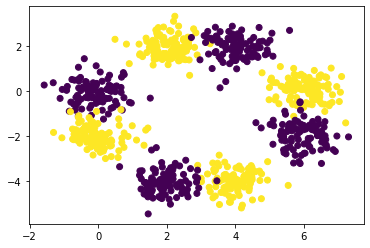

In [ ]:
#Load data, labels
n=100 
np.random.seed(12) #set random seed
std = 0.5
data1 = std*np.random.randn(n,2) #upper left
data2 = std*np.random.randn(n,2) #top left
data2[:,0] += 2
data2[:,1] += 2
data3 = std*np.random.randn(n,2) #top right
data3[:,0] += 4
data3[:,1] += 2
data4 = std*np.random.randn(n,2) #upper right
data4[:,0] += 6
data5 = std*np.random.randn(n,2) #lower right
data5[:,0] += 6
data5[:,1] -= 2
data6 = std*np.random.randn(n,2) #bottom right
data6[:,0] += 4
data6[:,1] -= 4
data7 = std*np.random.randn(n,2) #bottom left
data7[:,0] += 2
data7[:,1] -= 4
data8 = std*np.random.randn(n,2) #lower left
data8[:,1] -= 2
data = np.vstack([data1,data2,data3,data4,data5,data6,data7,data8])
labels = np.hstack([np.zeros(n),np.ones(n),np.zeros(n),np.ones(n),np.zeros(n),
                    np.ones(n),np.zeros(n),np.ones(n)]).astype('int')
np.random.seed()

#Build a knn weight matrix and plot the dataset
W = weight_matrix(data)
plt.scatter(data[:,0],data[:,1], c=labels)

Random Sampling
0.250000% training data


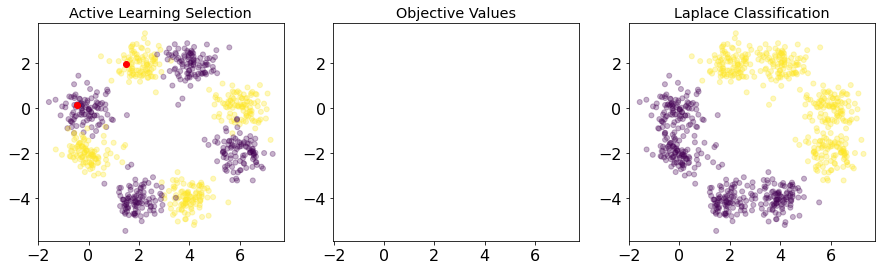

Number of Labels,Accuracy
Laplace: 2,49.875


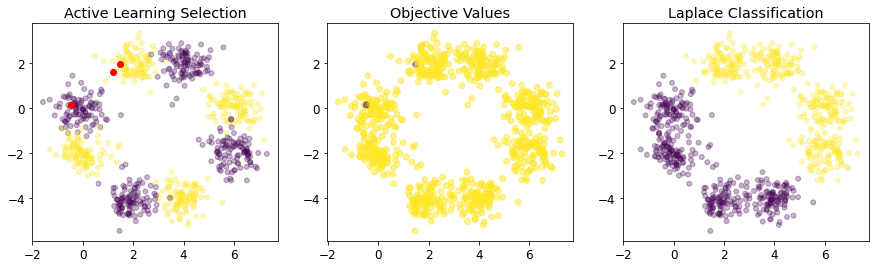

0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,49.812


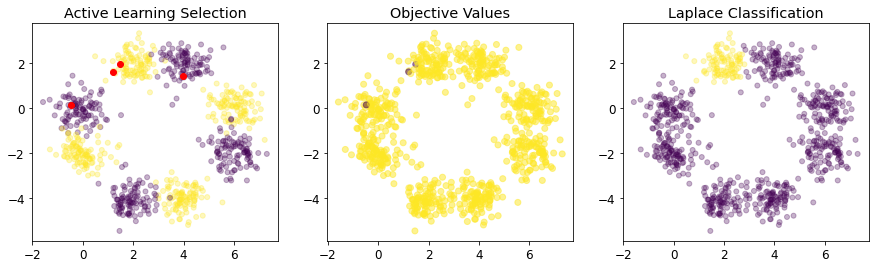

0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,61.558


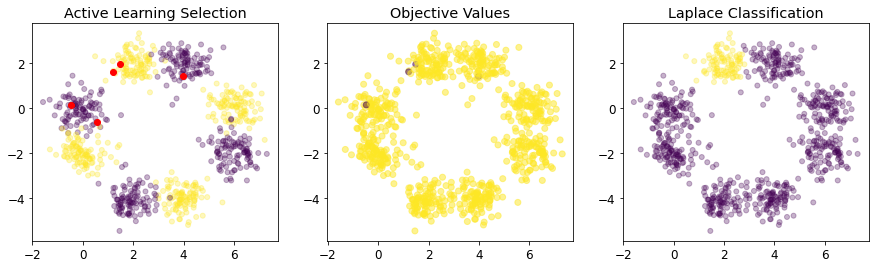

0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,61.509


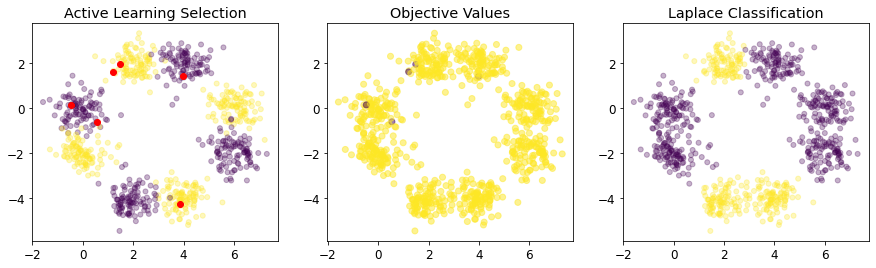

0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,61.965


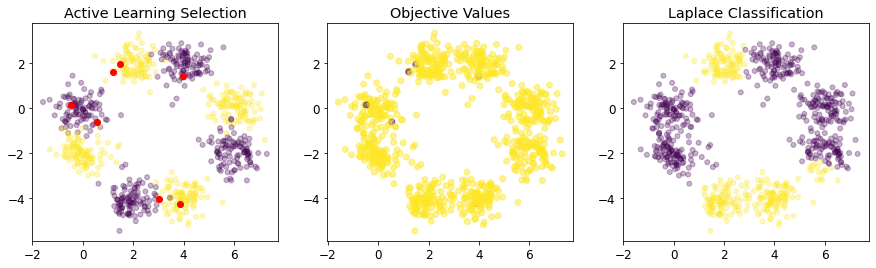

0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,59.899


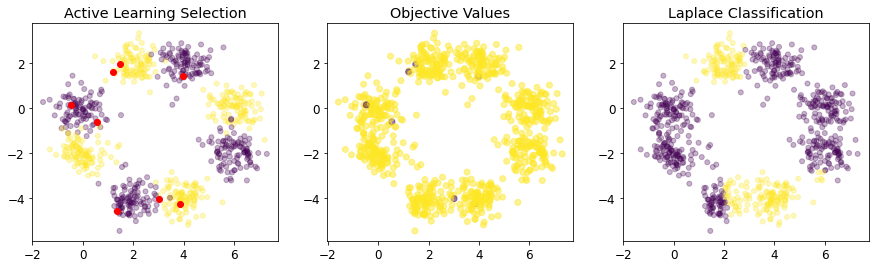

0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,68.939


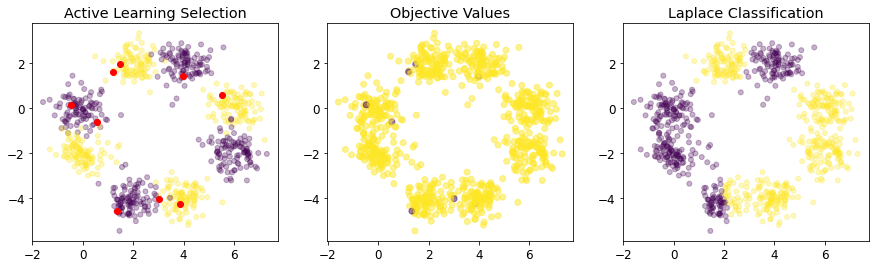

0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,69.532


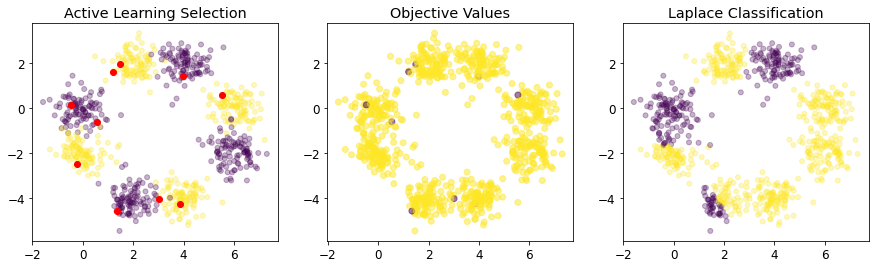

0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,76.709


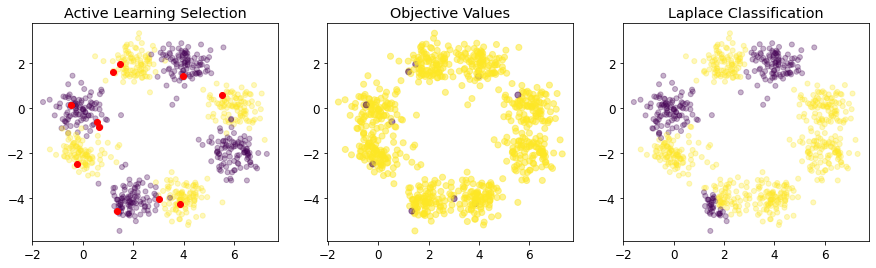

0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,77.820


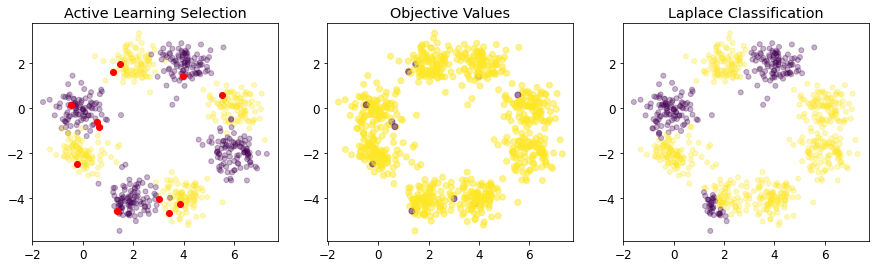

0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,77.792


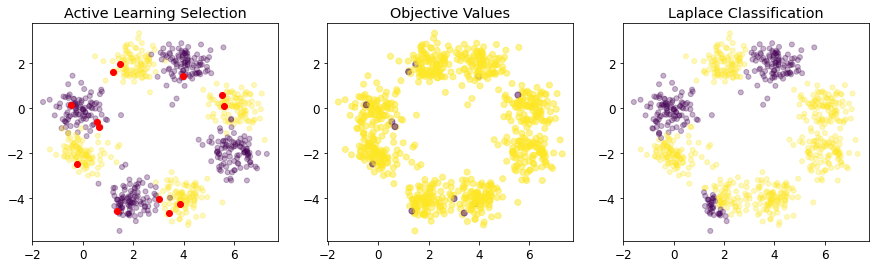

0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,77.764


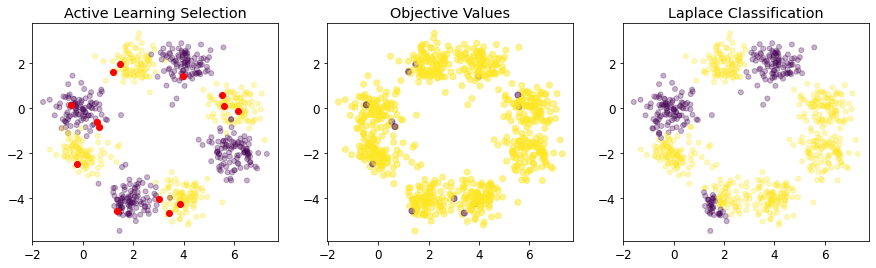

0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,77.735


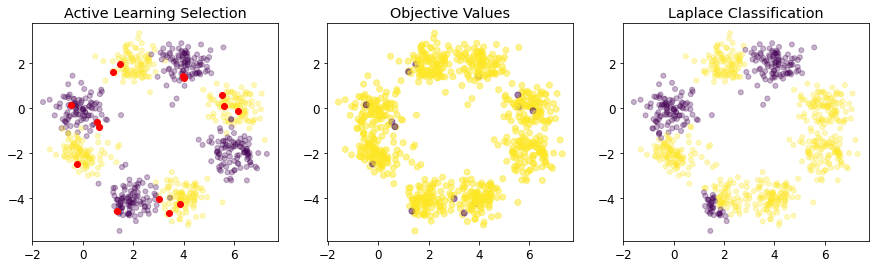

0.0 0.001272264631043257
Number of Labels,Accuracy
Laplace: 15,77.580


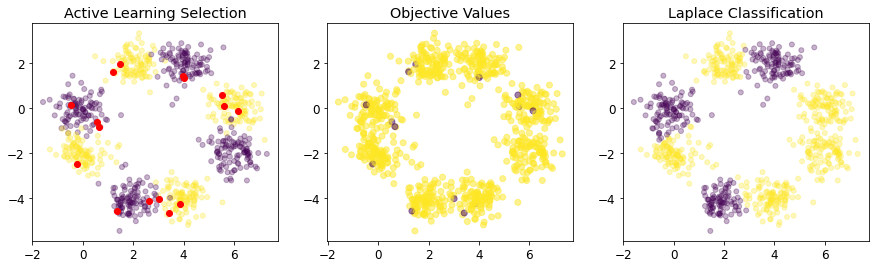

0.0 0.0012738853503184713
Number of Labels,Accuracy
Laplace: 16,84.056


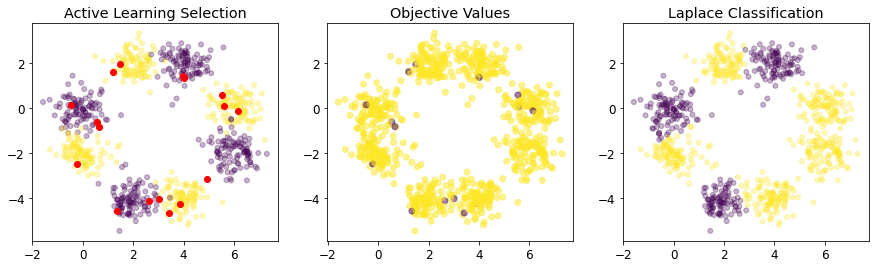

0.0 0.0012755102040816326
Number of Labels,Accuracy
Laplace: 17,84.036


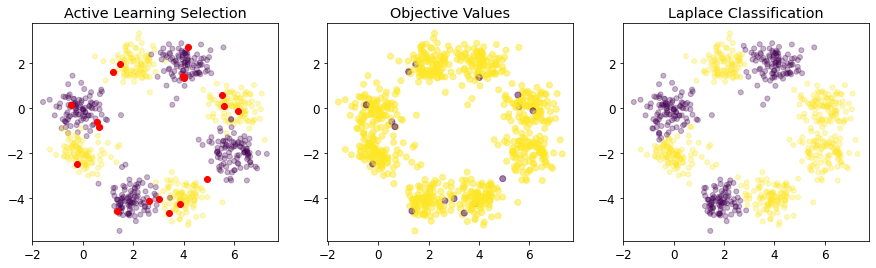

0.0 0.001277139208173691
Number of Labels,Accuracy
Laplace: 18,83.887


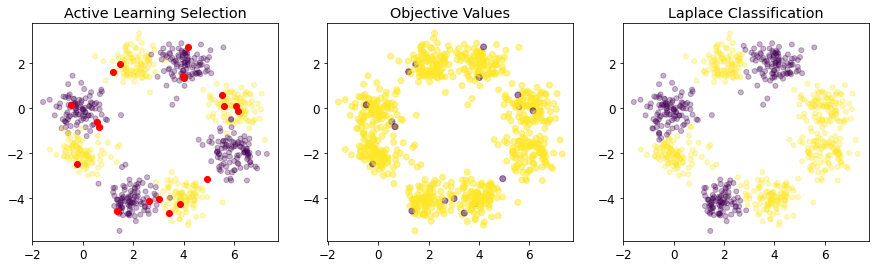

0.0 0.0012787723785166241
Number of Labels,Accuracy
Laplace: 19,83.867


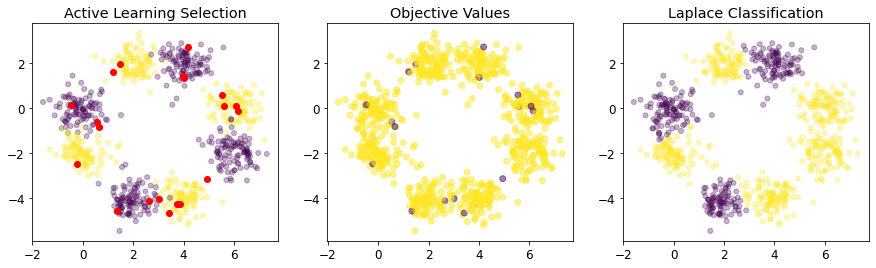

0.0 0.0012804097311139564
Number of Labels,Accuracy
Laplace: 20,83.846

Uncertainty Sampling
0.250000% training data


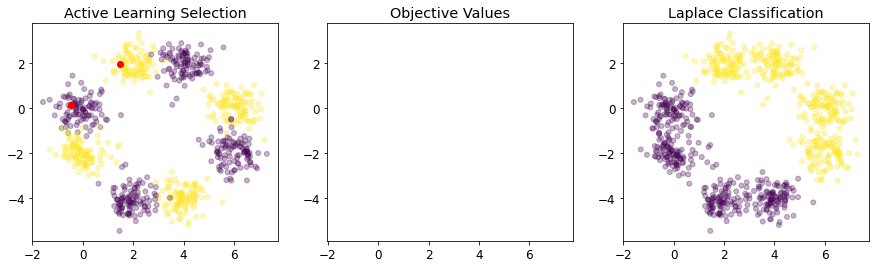

Number of Labels,Accuracy
Laplace: 2,49.875


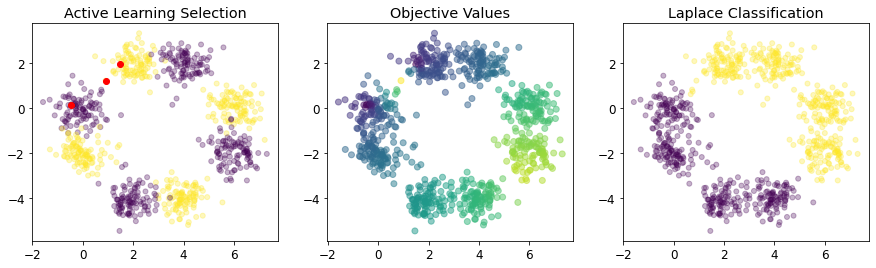

0.3803406055853444 0.6795795489341017
Number of Labels,Accuracy
Laplace: 3,49.435


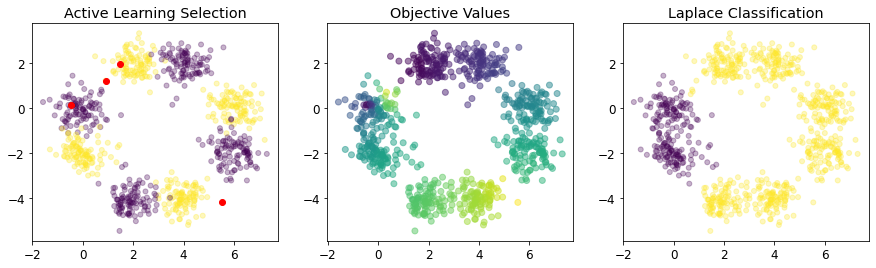

0.3803406055853444 0.6876826123891725
Number of Labels,Accuracy
Laplace: 4,49.749


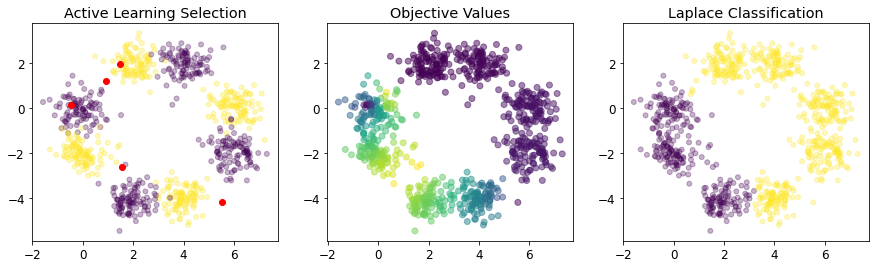

0.3803406055853444 0.689157578991806
Number of Labels,Accuracy
Laplace: 5,61.258


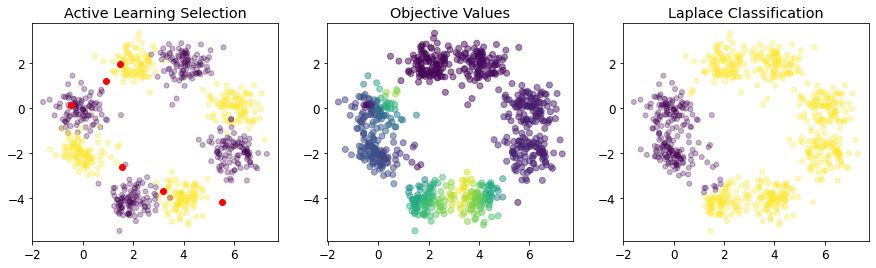

0.3803406055853444 0.6978806009955758
Number of Labels,Accuracy
Laplace: 6,50.630


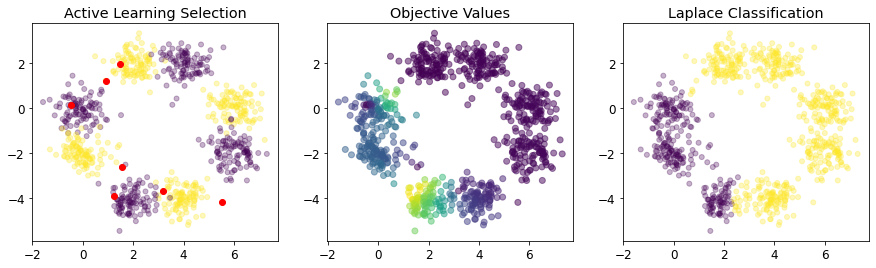

0.3803406055853444 0.7048888653759598
Number of Labels,Accuracy
Laplace: 7,59.395


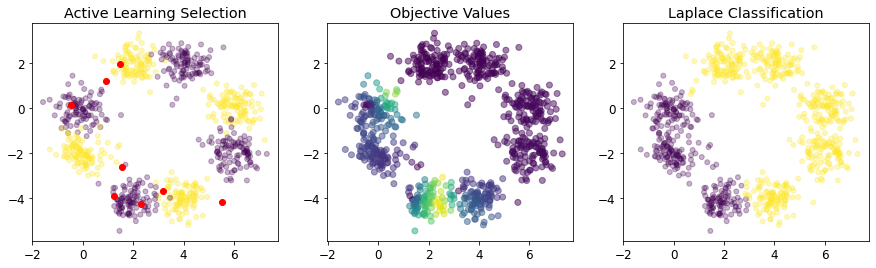

0.3803406055853444 0.7061880987603477
Number of Labels,Accuracy
Laplace: 8,61.237


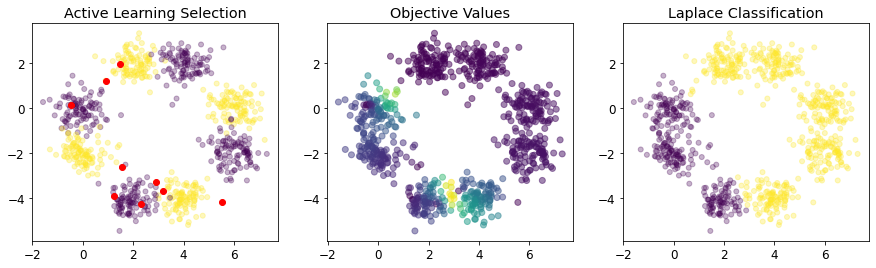

0.3803406055853444 0.6978118192205156
Number of Labels,Accuracy
Laplace: 9,60.683


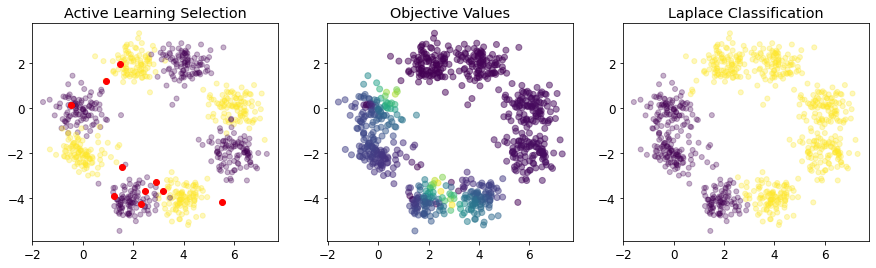

0.3803406055853444 0.6947920227633704
Number of Labels,Accuracy
Laplace: 10,60.759


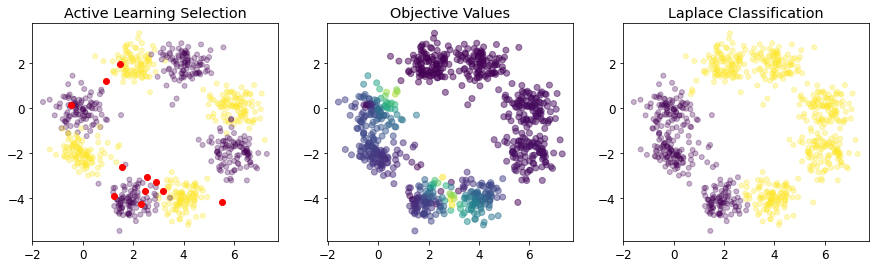

0.3803406055853444 0.6923026784155969
Number of Labels,Accuracy
Laplace: 11,60.837


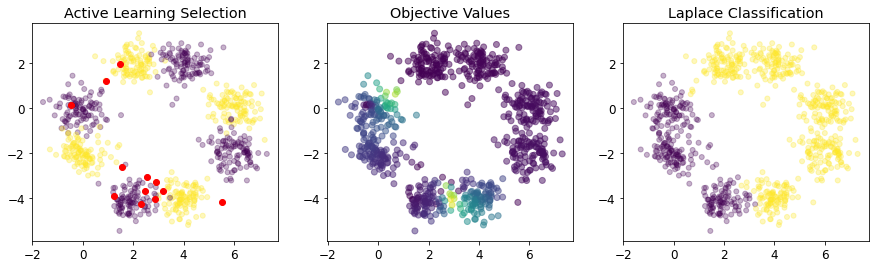

0.3803406055853444 0.6951834867931391
Number of Labels,Accuracy
Laplace: 12,60.787


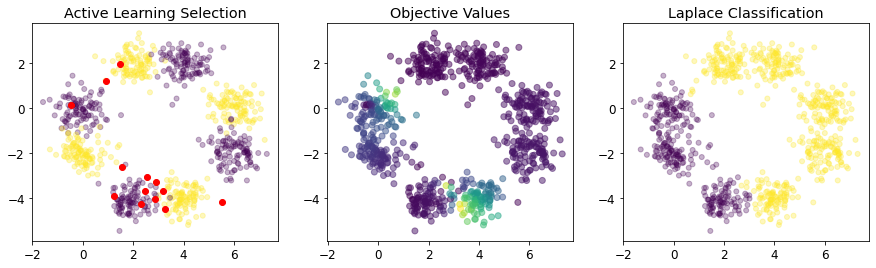

0.3803406055853444 0.7037311540457053
Number of Labels,Accuracy
Laplace: 13,60.864


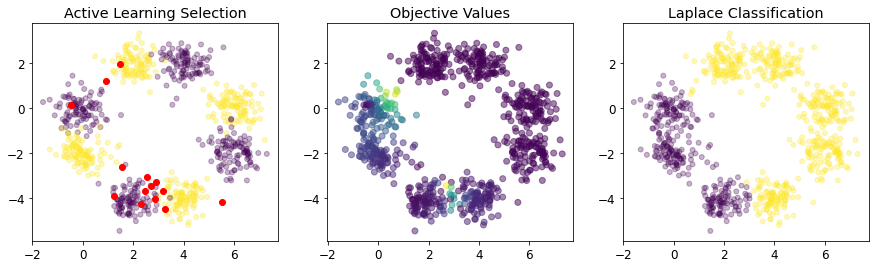

0.3803406055853444 0.6740357590586459
Number of Labels,Accuracy
Laplace: 14,61.069


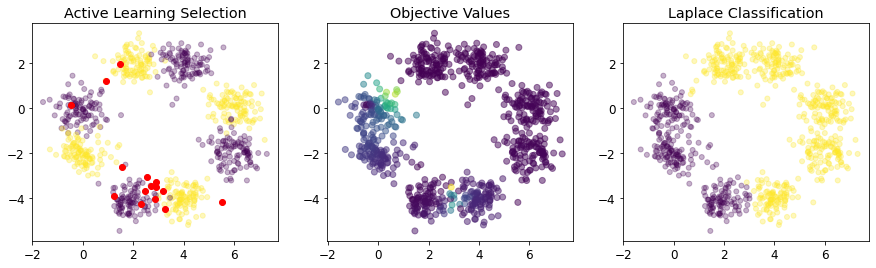

0.3803406055853444 0.6917671921665668
Number of Labels,Accuracy
Laplace: 15,61.019


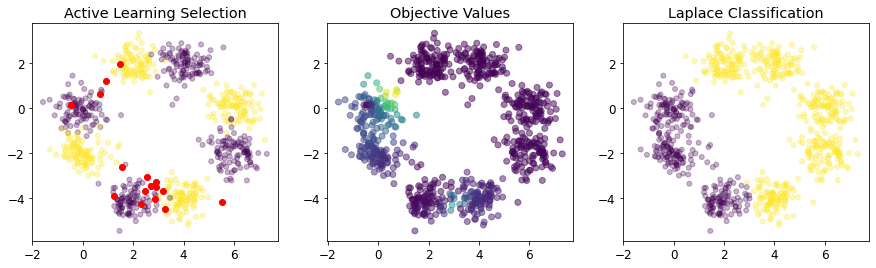

0.3803406055853444 0.6583323190912093
Number of Labels,Accuracy
Laplace: 16,61.352


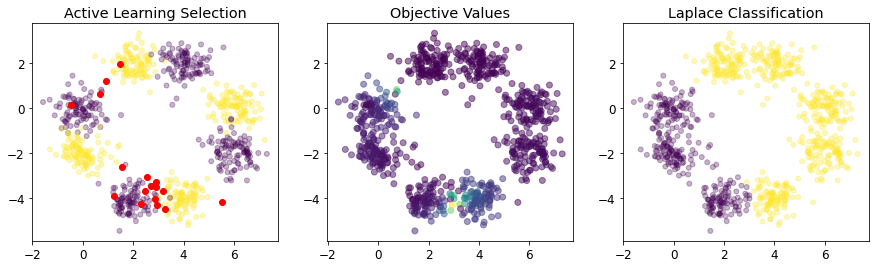

0.3803406055853444 0.5336437056861932
Number of Labels,Accuracy
Laplace: 17,61.303


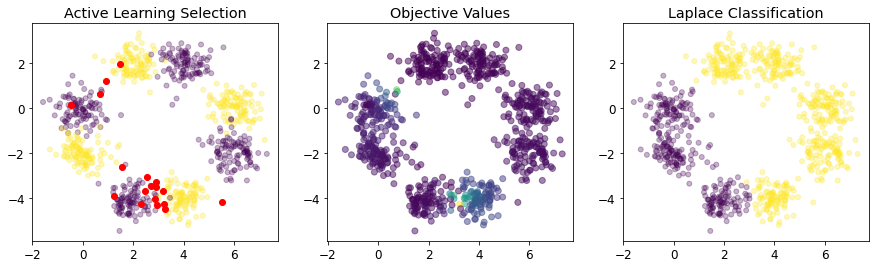

0.3803406055853444 0.528842813102251
Number of Labels,Accuracy
Laplace: 18,61.253


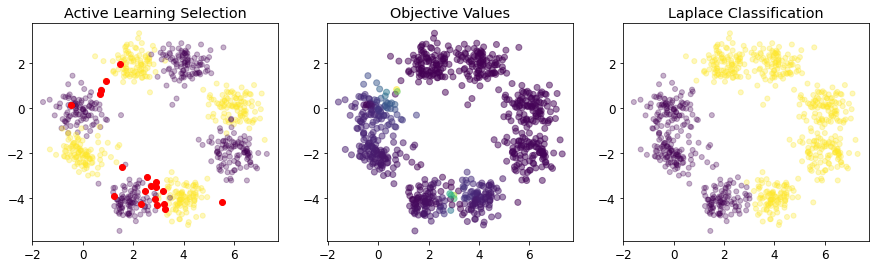

0.3803406055853444 0.4997864006372515
Number of Labels,Accuracy
Laplace: 19,61.204


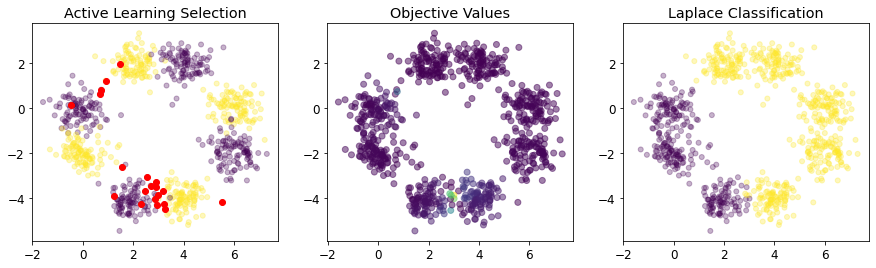

0.3803406055853444 0.4832900235679631
Number of Labels,Accuracy
Laplace: 20,61.026

V-Optimality
0.250000% training data


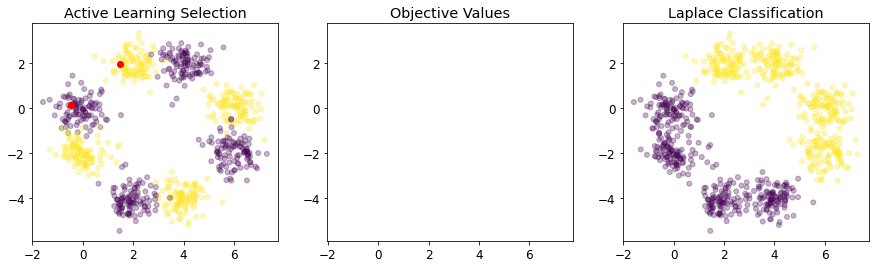

Number of Labels,Accuracy
Laplace: 2,49.875
negative diagonals: 0
negative entries: 37318
negative diagonals: 0
negative entries: 279322


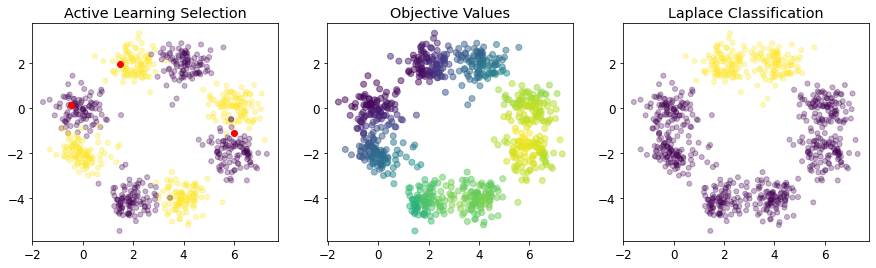

18.735739062573114 2022.2106196634732
Number of Labels,Accuracy
Laplace: 3,49.812
negative diagonals: 0
negative entries: 296106


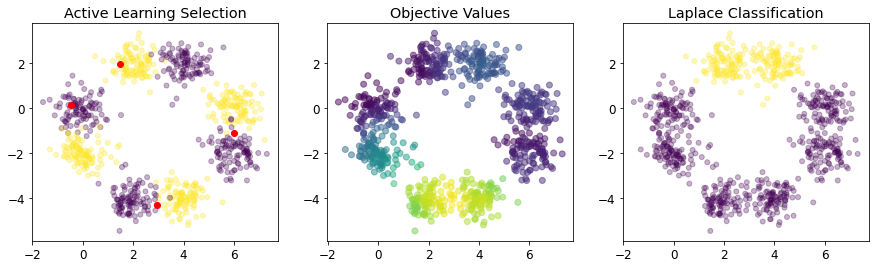

18.73494980876443 1264.4068777148143
Number of Labels,Accuracy
Laplace: 4,49.749
negative diagonals: 0
negative entries: 297692


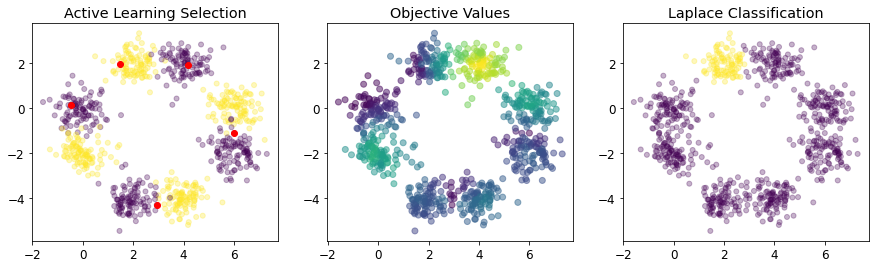

18.478925688016172 386.24124809542366
Number of Labels,Accuracy
Laplace: 5,61.384
negative diagonals: 0
negative entries: 306436


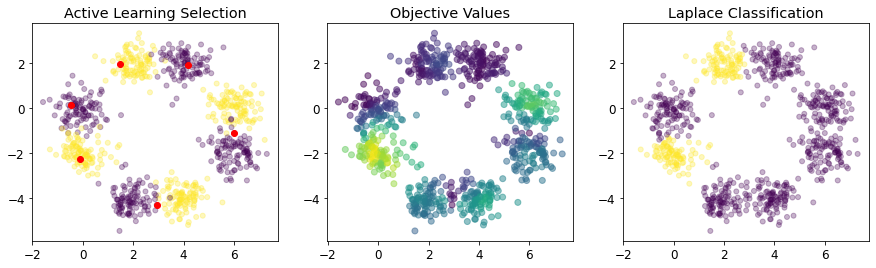

18.45379660418095 258.9257385145976
Number of Labels,Accuracy
Laplace: 6,72.796
negative diagonals: 0
negative entries: 319252


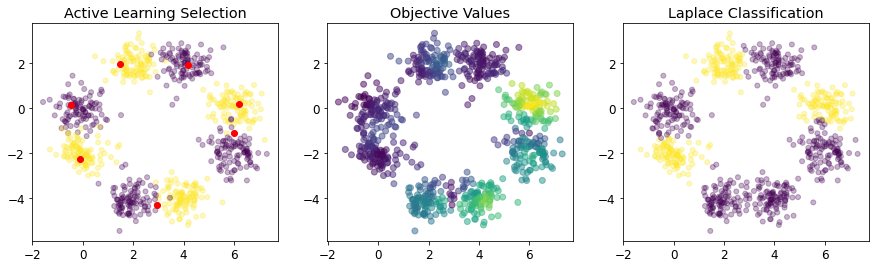

17.720955779014012 199.59067518593454
Number of Labels,Accuracy
Laplace: 7,84.615
negative diagonals: 0
negative entries: 304200


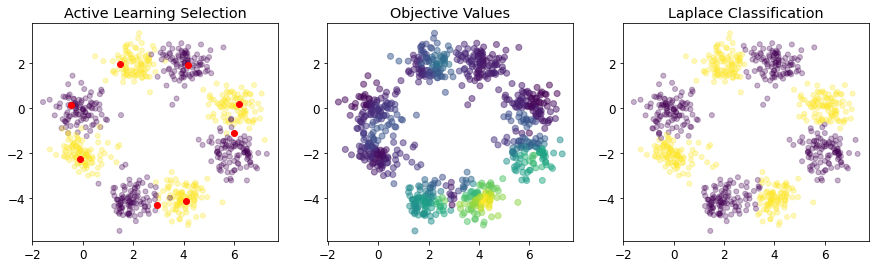

17.136442509750562 164.03325667572335
Number of Labels,Accuracy
Laplace: 8,96.086
negative diagonals: 0
negative entries: 306592


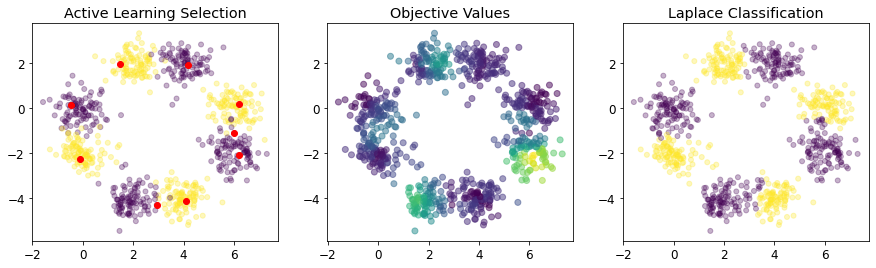

16.590628853948786 119.24638426065921
Number of Labels,Accuracy
Laplace: 9,95.449
negative diagonals: 0
negative entries: 310266


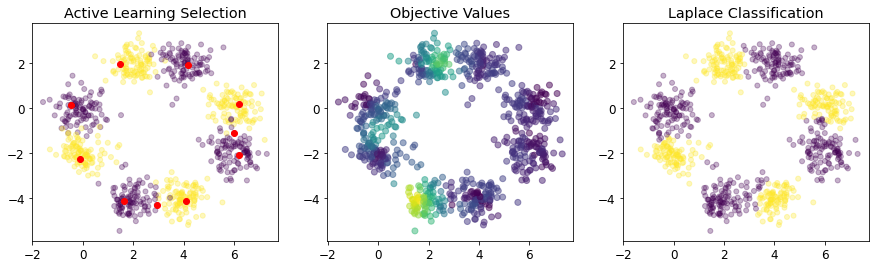

16.50424925946929 91.25584499048523
Number of Labels,Accuracy
Laplace: 10,95.063
negative diagonals: 0
negative entries: 319628


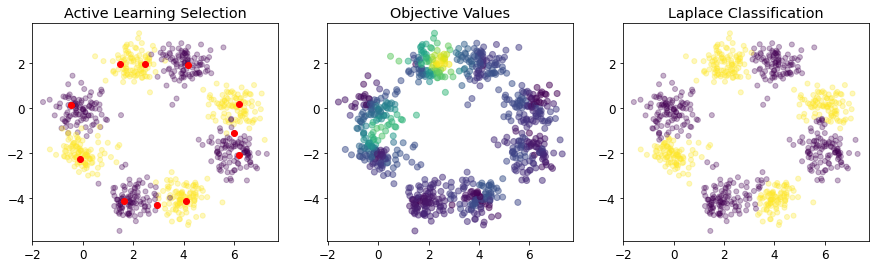

16.307243318820433 71.99118601204408
Number of Labels,Accuracy
Laplace: 11,95.311
negative diagonals: 0
negative entries: 326392


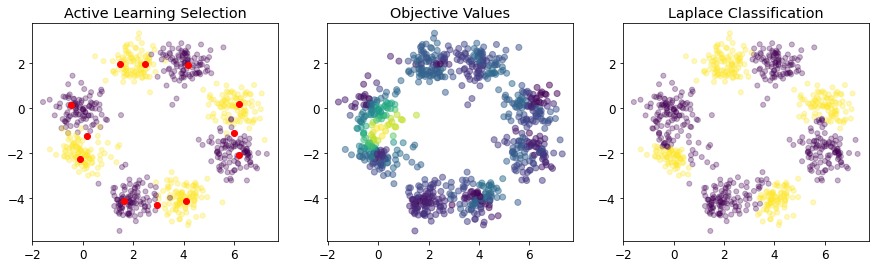

16.307241961295354 56.39769851934408
Number of Labels,Accuracy
Laplace: 12,92.259
negative diagonals: 0
negative entries: 326150


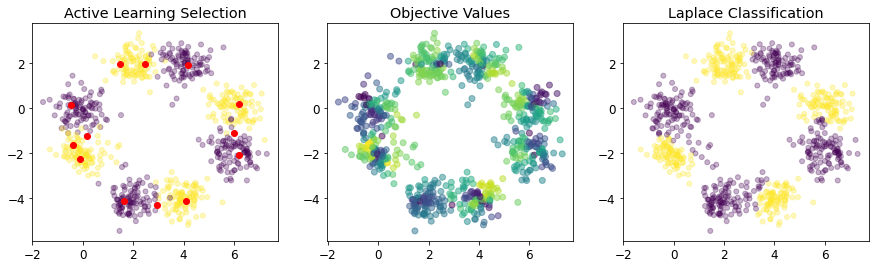

15.72321572731038 32.13805448137901
Number of Labels,Accuracy
Laplace: 13,94.536
negative diagonals: 0
negative entries: 323926


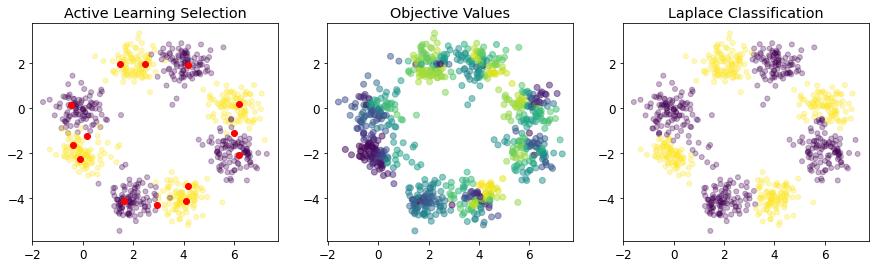

15.250337957129693 31.051088532458657
Number of Labels,Accuracy
Laplace: 14,95.674
negative diagonals: 0
negative entries: 320860


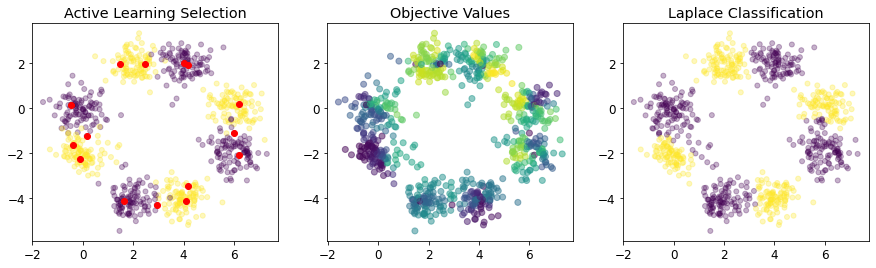

15.251432486785164 30.23283045608133
Number of Labels,Accuracy
Laplace: 15,95.669
negative diagonals: 0
negative entries: 321420


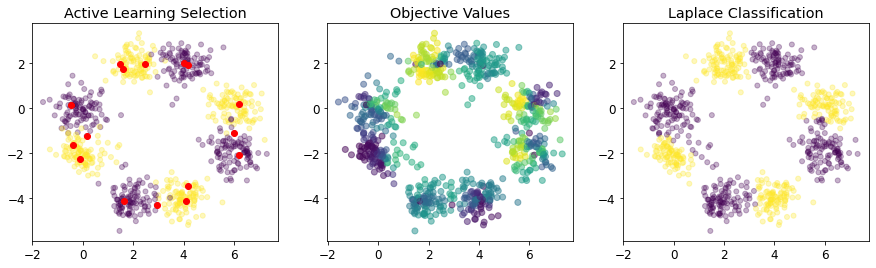

15.251440771740793 29.16506639842247
Number of Labels,Accuracy
Laplace: 16,95.663
negative diagonals: 0
negative entries: 313478


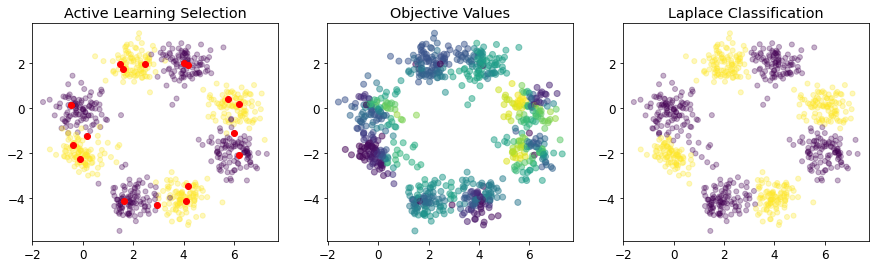

15.251725520298994 29.146647131248486
Number of Labels,Accuracy
Laplace: 17,96.169
negative diagonals: 0
negative entries: 314314


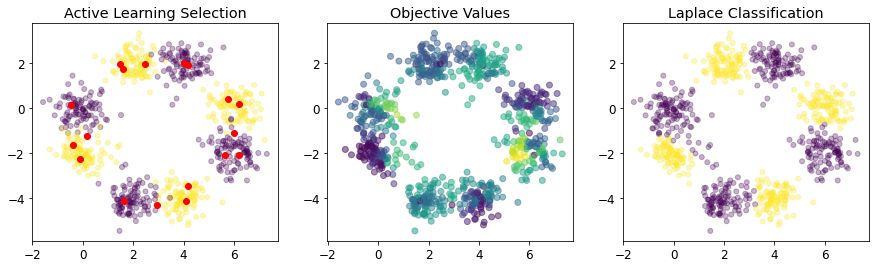

15.251692724404053 28.679929103463323
Number of Labels,Accuracy
Laplace: 18,96.036
negative diagonals: 0
negative entries: 309246


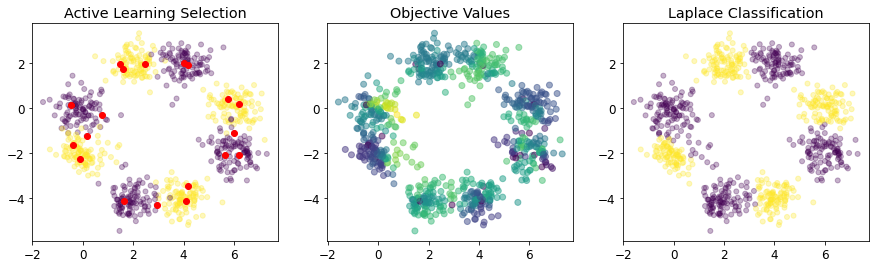

13.183594899985172 27.03079429725443
Number of Labels,Accuracy
Laplace: 19,95.775
negative diagonals: 0
negative entries: 309944


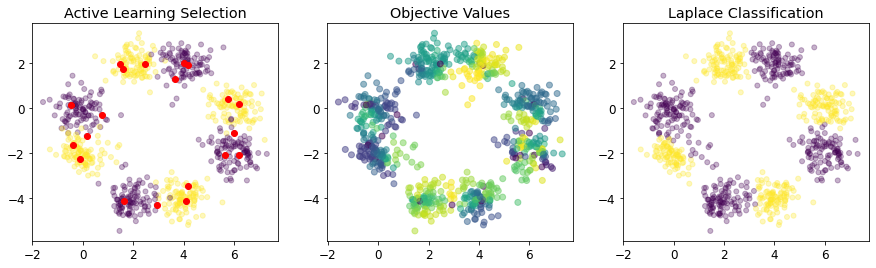

13.183587416424626 23.37082290223133
Number of Labels,Accuracy
Laplace: 20,95.769

Sigma-Optimality
0.250000% training data


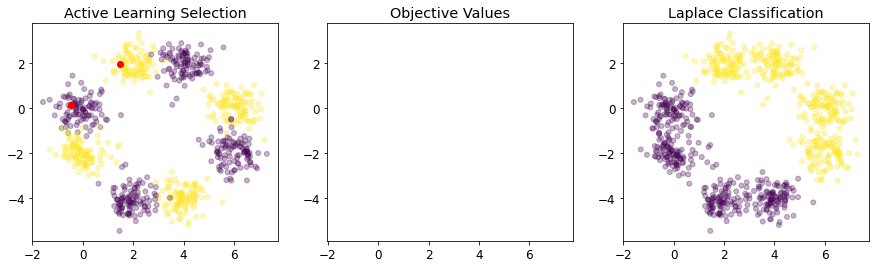

Number of Labels,Accuracy
Laplace: 2,49.875
negative diagonals: 0
negative entries: 37318
negative diagonals: 0
negative entries: 309136


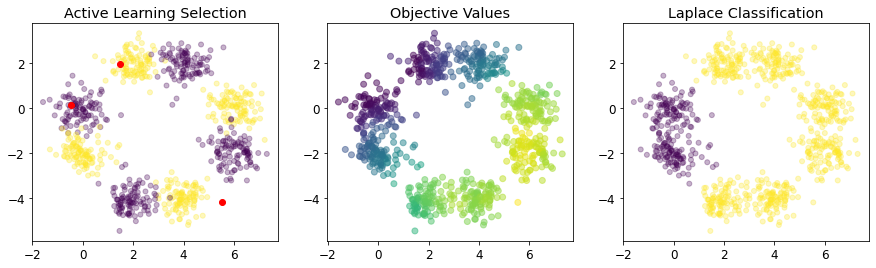

1.1880739916694163 849267.6439732357
Number of Labels,Accuracy
Laplace: 3,50.188
negative diagonals: 0
negative entries: 275864


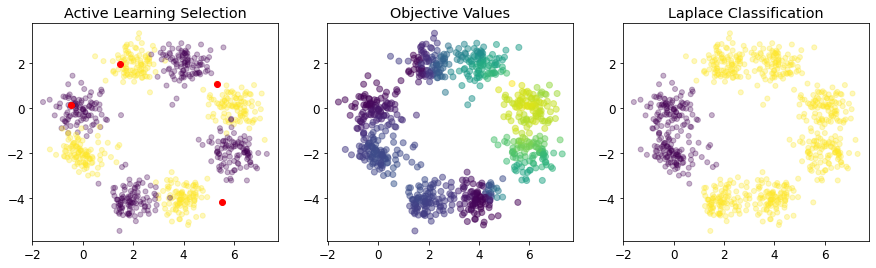

1.551290043020153 288901.0321426684
Number of Labels,Accuracy
Laplace: 4,50.126
negative diagonals: 0
negative entries: 300640


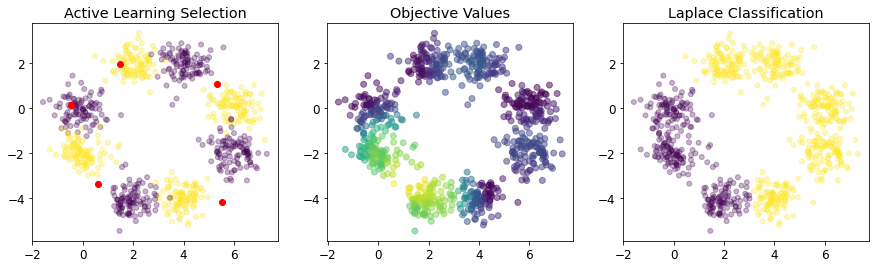

1.0378715640391056 96537.09724490021
Number of Labels,Accuracy
Laplace: 5,61.761
negative diagonals: 0
negative entries: 303728


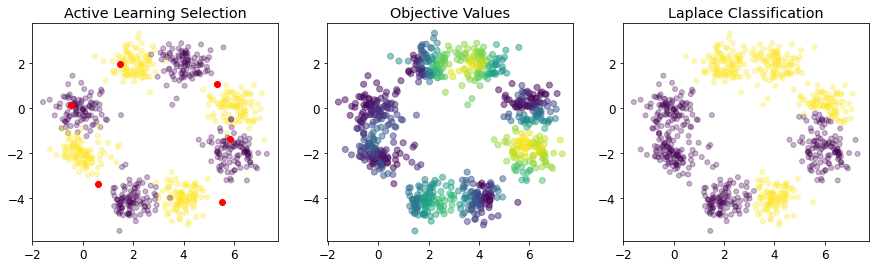

0.010570070413656438 28412.00619218098
Number of Labels,Accuracy
Laplace: 6,72.040
negative diagonals: 0
negative entries: 311290


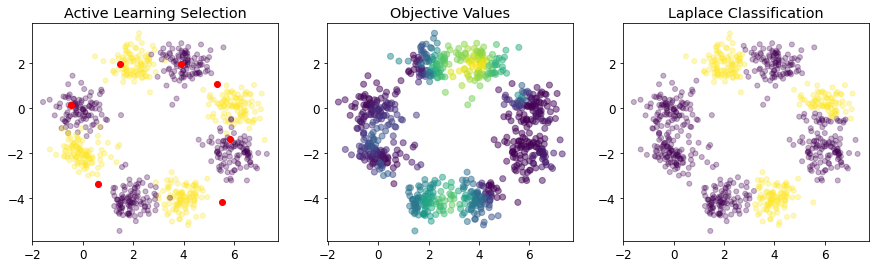

0.08492227391398878 33452.85412685369
Number of Labels,Accuracy
Laplace: 7,82.976
negative diagonals: 0
negative entries: 306742


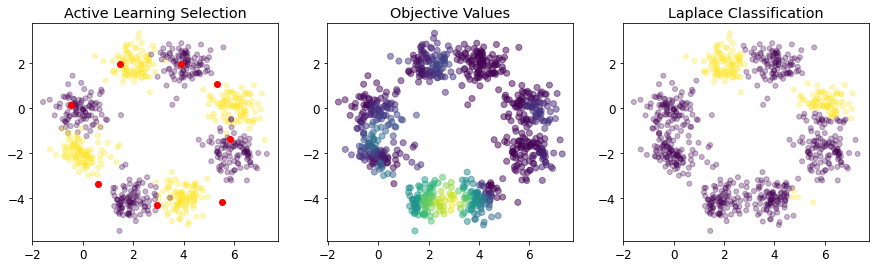

0.010047572986575137 25838.22306385514
Number of Labels,Accuracy
Laplace: 8,71.465
negative diagonals: 0
negative entries: 325574


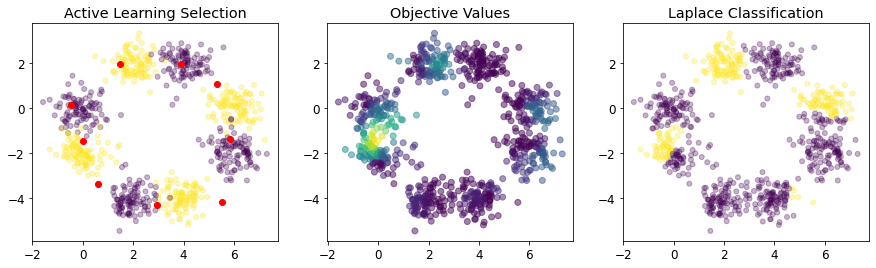

0.0016293893242711297 11391.587753868176
Number of Labels,Accuracy
Laplace: 9,76.991
negative diagonals: 0
negative entries: 325400


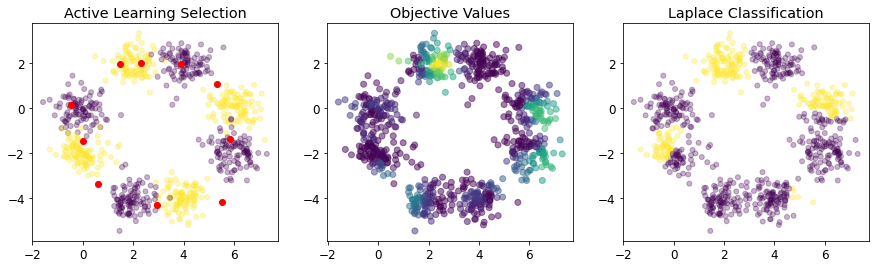

0.0003756255901497547 5458.738582232828
Number of Labels,Accuracy
Laplace: 10,77.215
negative diagonals: 0
negative entries: 328102


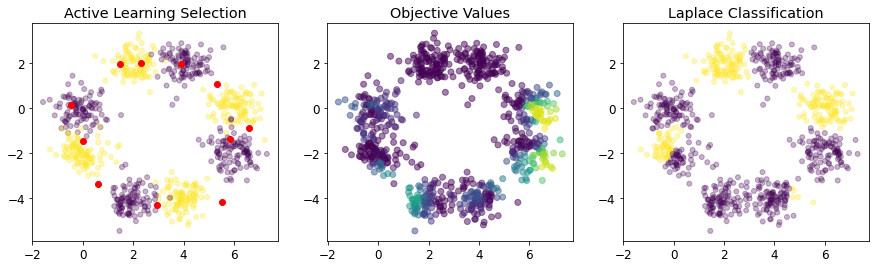

0.00036443167183635843 3881.7133081190777
Number of Labels,Accuracy
Laplace: 11,79.594
negative diagonals: 0
negative entries: 322428


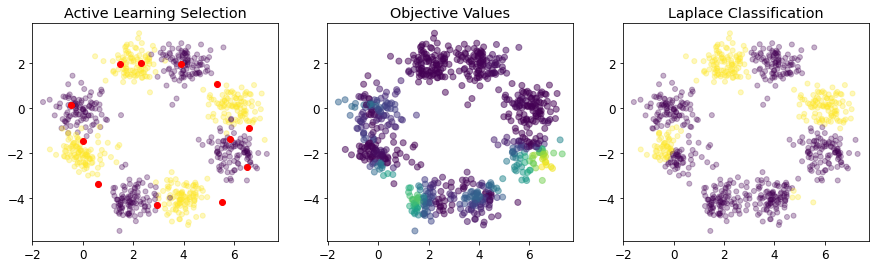

1.1800110072497722e-05 3110.496279222081
Number of Labels,Accuracy
Laplace: 12,79.569
negative diagonals: 0
negative entries: 319780


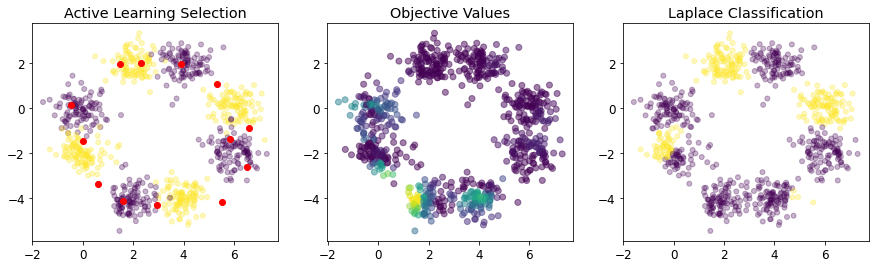

2.7471440335256584e-05 2244.3330295420196
Number of Labels,Accuracy
Laplace: 13,79.416
negative diagonals: 0
negative entries: 316580


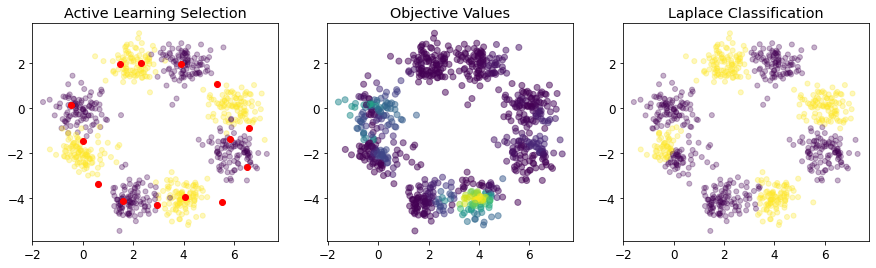

1.6934489666212722e-07 1714.0162127797169
Number of Labels,Accuracy
Laplace: 14,90.458
negative diagonals: 0
negative entries: 321488


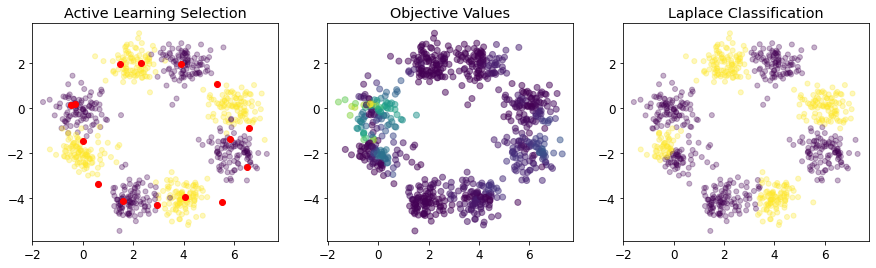

3.473032727341603e-05 1006.4188899442338
Number of Labels,Accuracy
Laplace: 15,90.191
negative diagonals: 0
negative entries: 317262


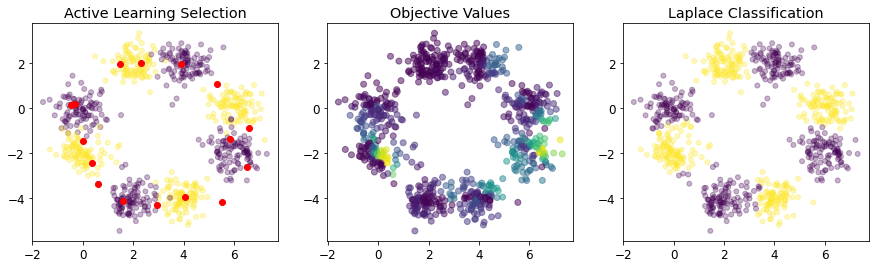

8.103052875381311e-07 275.6115811709459
Number of Labels,Accuracy
Laplace: 16,96.046
negative diagonals: 0
negative entries: 318380


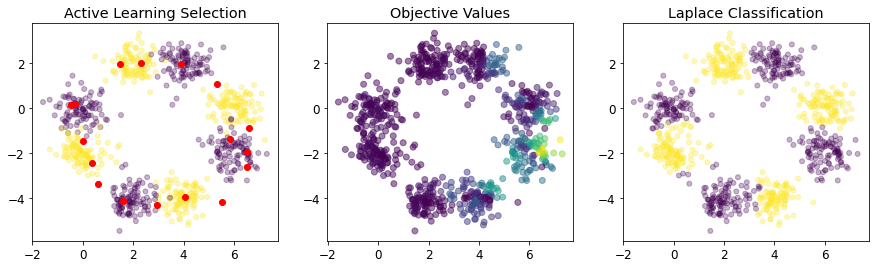

0.00101676269462171 269.03355004633323
Number of Labels,Accuracy
Laplace: 17,96.041
negative diagonals: 0
negative entries: 312770


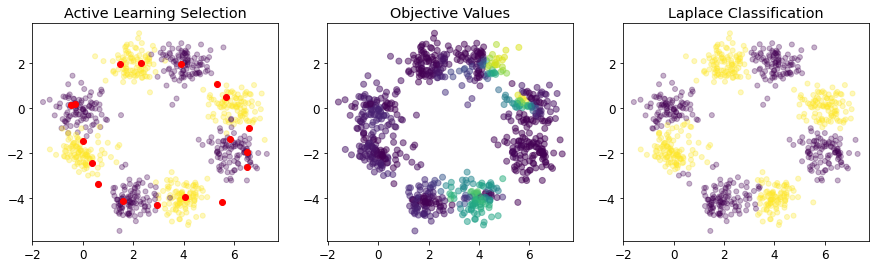

3.1978613883896405e-05 94.08973115650271
Number of Labels,Accuracy
Laplace: 18,95.908
negative diagonals: 0
negative entries: 309712


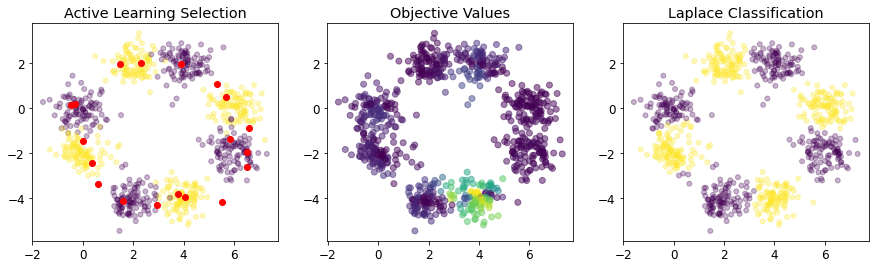

0.0005796521847975825 72.18262379667244
Number of Labels,Accuracy
Laplace: 19,96.543
negative diagonals: 0
negative entries: 307446


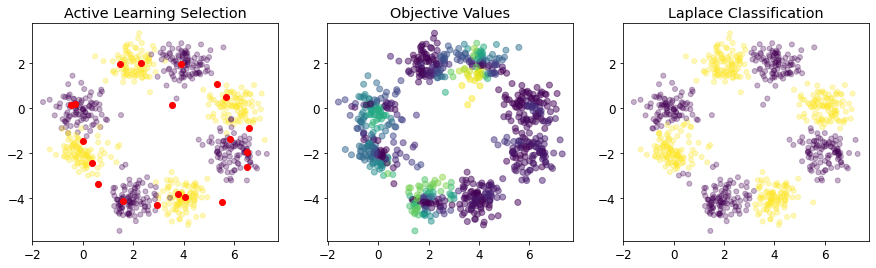

6.862560558070455e-06 14.976944738224844
Number of Labels,Accuracy
Laplace: 20,96.538

Model Change
0.250000% training data


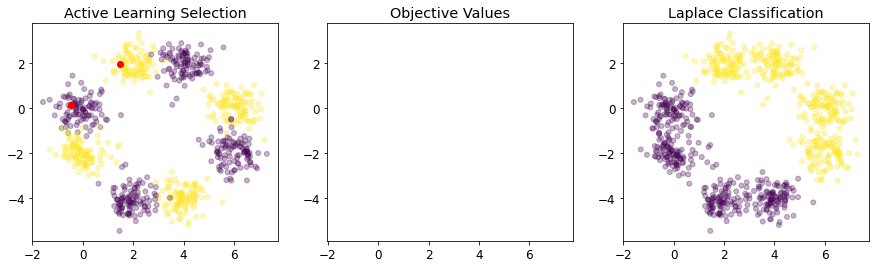

Number of Labels,Accuracy
Laplace: 2,49.875
negative diagonals: 0
negative entries: 37318
negative diagonals: 0
negative entries: 34722


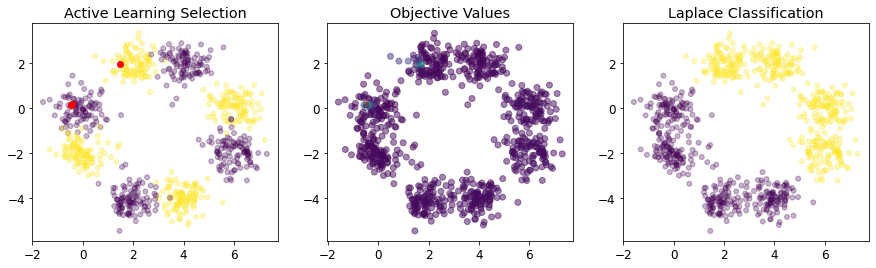

2.695985496795105 159.52783066971787
Number of Labels,Accuracy
Laplace: 3,49.812
negative diagonals: 0
negative entries: 58314


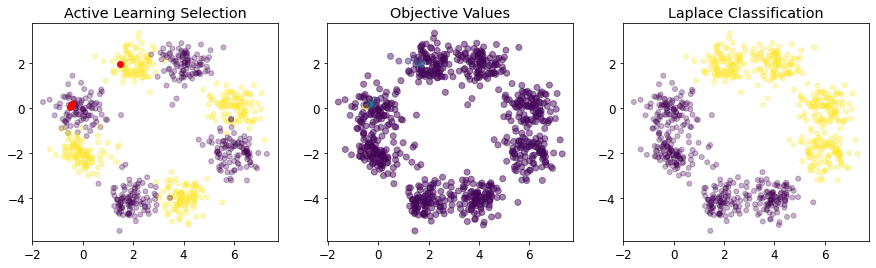

3.068266734893828 219.29768211484551
Number of Labels,Accuracy
Laplace: 4,49.749
negative diagonals: 0
negative entries: 75964


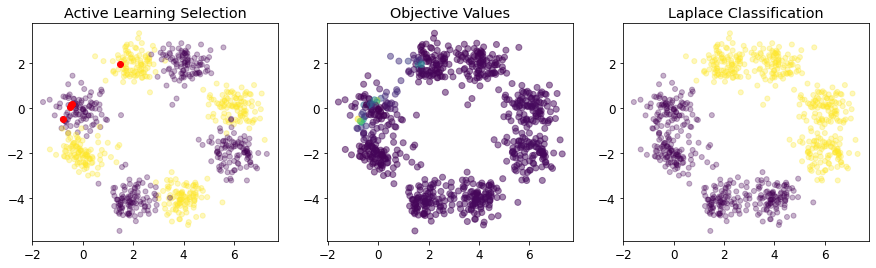

3.8991287839580355 166.2296064501491
Number of Labels,Accuracy
Laplace: 5,49.686
negative diagonals: 0
negative entries: 89174


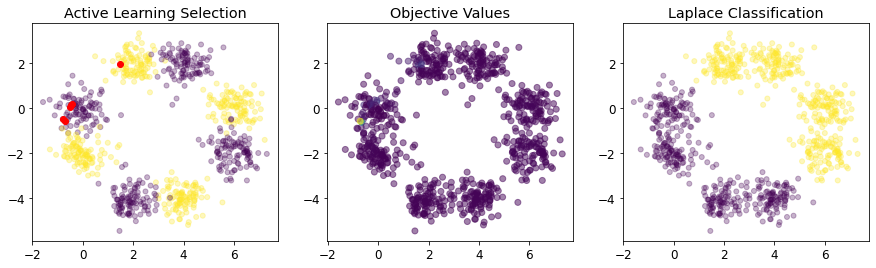

2.562436087113085 451.3522543878347
Number of Labels,Accuracy
Laplace: 6,49.622
negative diagonals: 0
negative entries: 108482


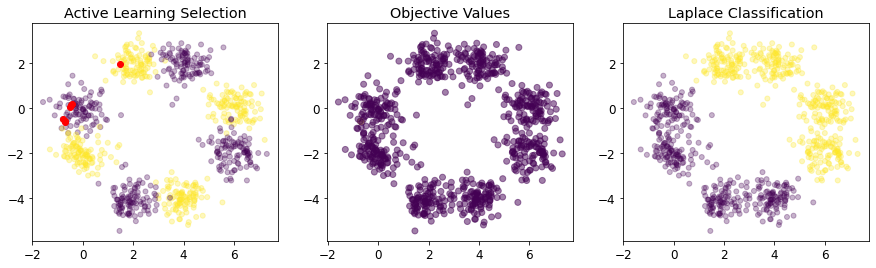

2.9046782205734587 34293.23198972262
Number of Labels,Accuracy
Laplace: 7,49.559
negative diagonals: 0
negative entries: 168584


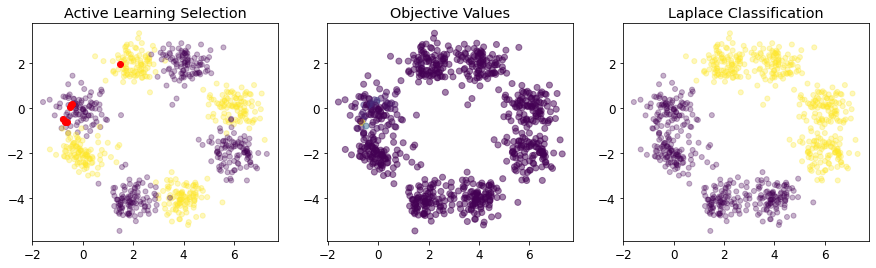

3.9004898823229674 3210.8038361353438
Number of Labels,Accuracy
Laplace: 8,49.495
negative diagonals: 0
negative entries: 154122


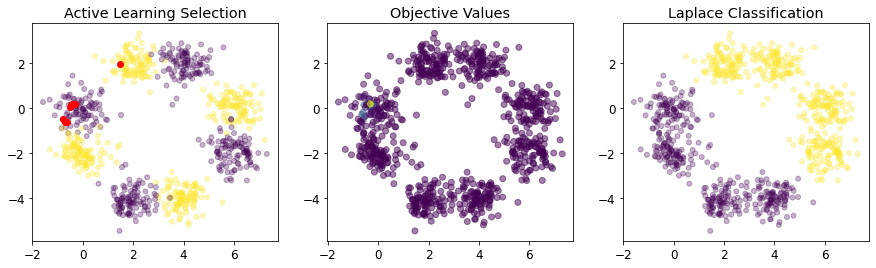

2.701887434297936 25598.854913451167
Number of Labels,Accuracy
Laplace: 9,49.431
negative diagonals: 0
negative entries: 150962


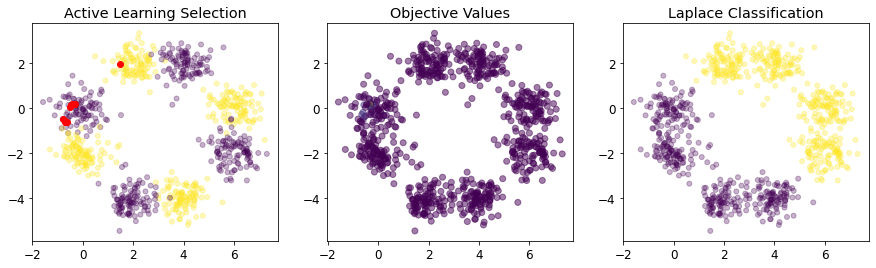

3.641543164874754 65164.20233709155
Number of Labels,Accuracy
Laplace: 10,49.367
negative diagonals: 0
negative entries: 126904


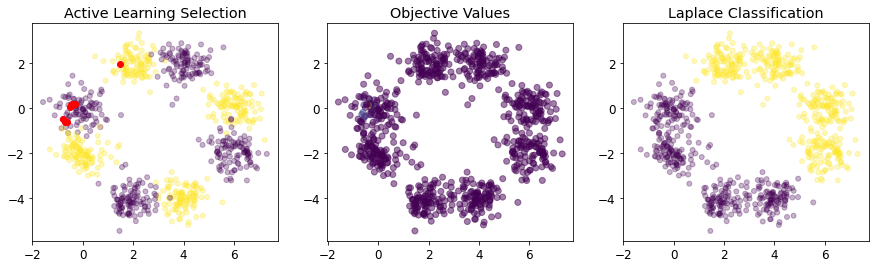

4.356546526928634 105877.48547496514
Number of Labels,Accuracy
Laplace: 11,49.303
negative diagonals: 44
negative entries: 118060


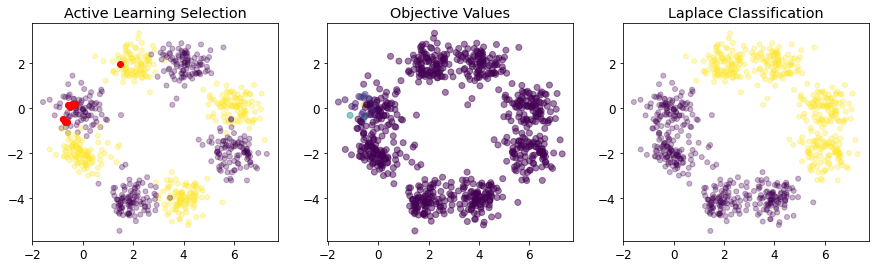

5.024417160246295 3076774.749451764
Number of Labels,Accuracy
Laplace: 12,49.239
negative diagonals: 193
negative entries: 205137


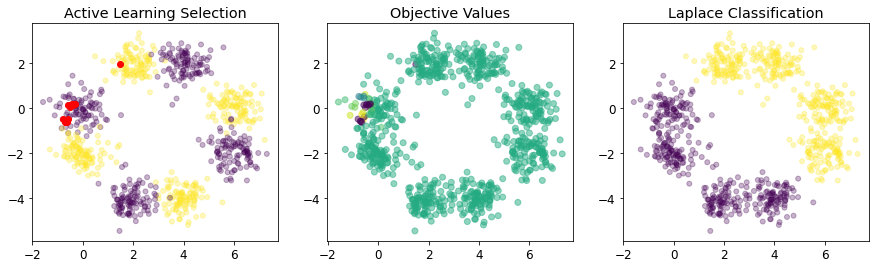

-3331337.2254397827 2103441.2466207854
Number of Labels,Accuracy
Laplace: 13,49.174
negative diagonals: 340
negative entries: 373600


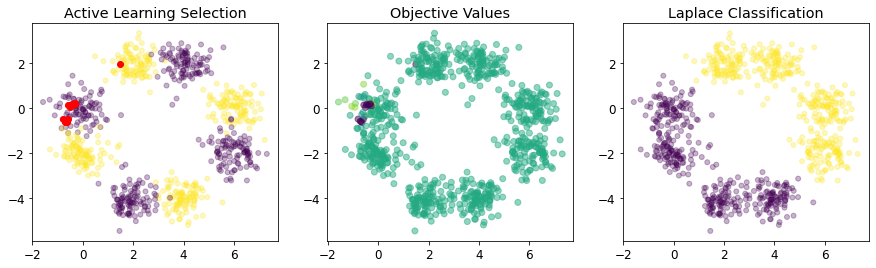

-11067340.22564388 7136925.312567345
Number of Labels,Accuracy
Laplace: 14,49.109
negative diagonals: 399
negative entries: 405613


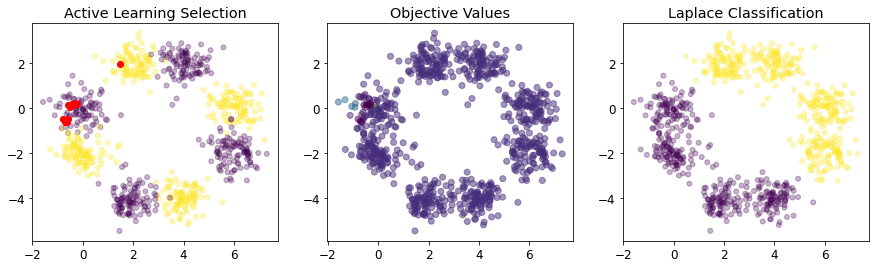

-2283763.8968921322 15900181.43290274
Number of Labels,Accuracy
Laplace: 15,49.045
negative diagonals: 505
negative entries: 418177


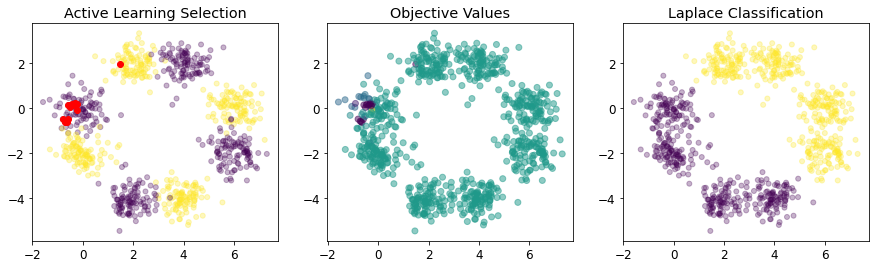

-3462769.746618168 2997408.0970564107
Number of Labels,Accuracy
Laplace: 16,48.980
negative diagonals: 768
negative entries: 410948


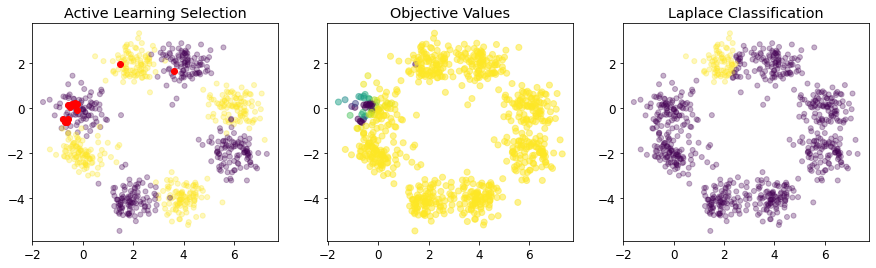

-3753955.844001242 1999.5590633584075
Number of Labels,Accuracy
Laplace: 17,58.493
negative diagonals: 771
negative entries: 410421


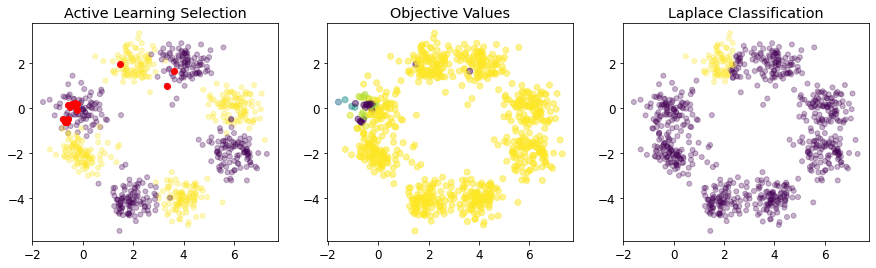

-19546733.254018378 3942.982240904955
Number of Labels,Accuracy
Laplace: 18,57.801
negative diagonals: 781
negative entries: 411241


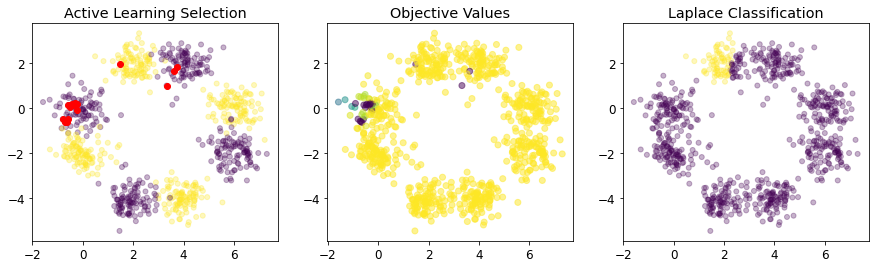

-20423510.53160212 11170.369007543875
Number of Labels,Accuracy
Laplace: 19,57.234
negative diagonals: 400
negative entries: 258198


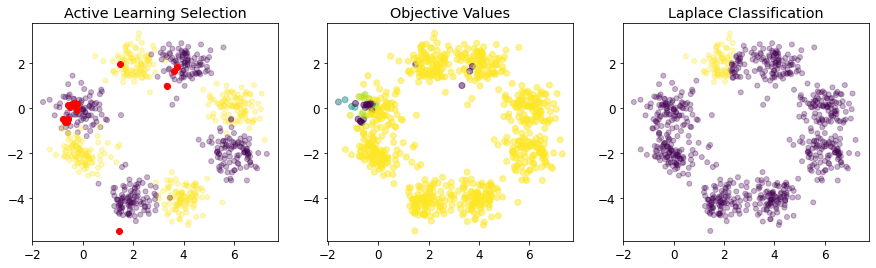

-20788277.83338081 -4.021582575232321
Number of Labels,Accuracy
Laplace: 20,57.179

MC-VOptimality
0.250000% training data


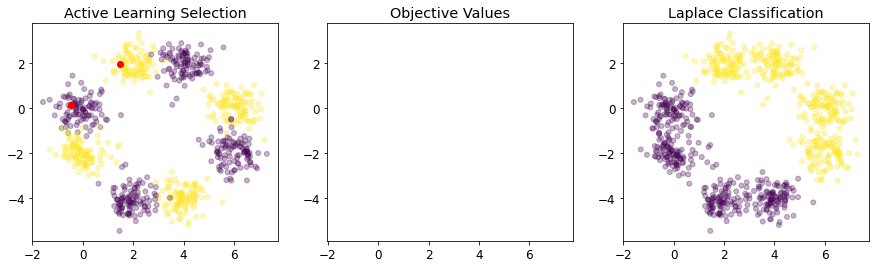

Number of Labels,Accuracy
Laplace: 2,49.875
negative diagonals: 0
negative entries: 37318
negative diagonals: 0
negative entries: 270128


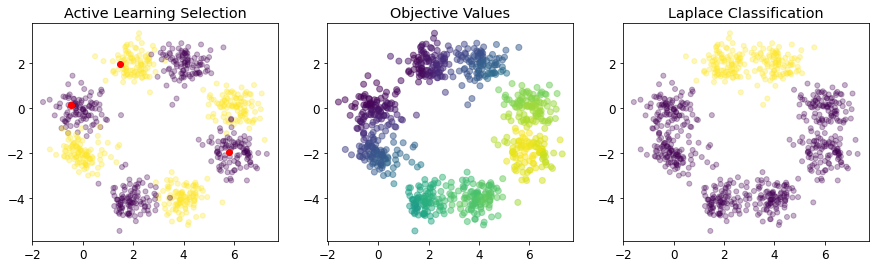

7.931431137291411 1249.450513443975
Number of Labels,Accuracy
Laplace: 3,49.812
negative diagonals: 0
negative entries: 252336


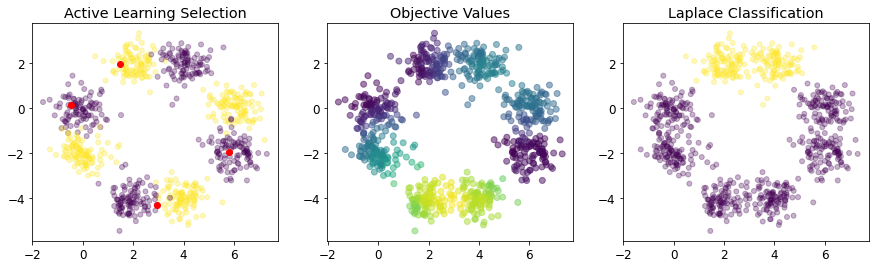

7.779016189040799 531.8764646405538
Number of Labels,Accuracy
Laplace: 4,49.749
negative diagonals: 0
negative entries: 274324


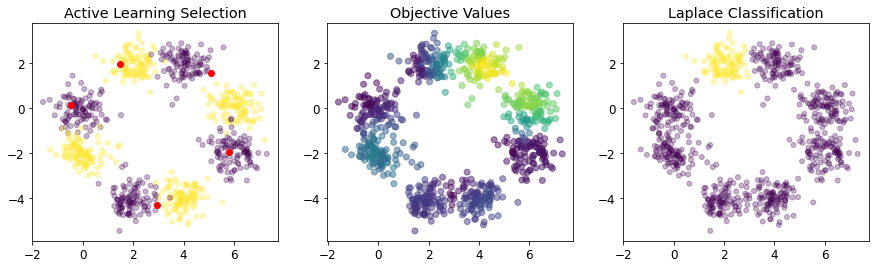

7.7240817259266095 245.2794276398466
Number of Labels,Accuracy
Laplace: 5,61.761
negative diagonals: 0
negative entries: 296808


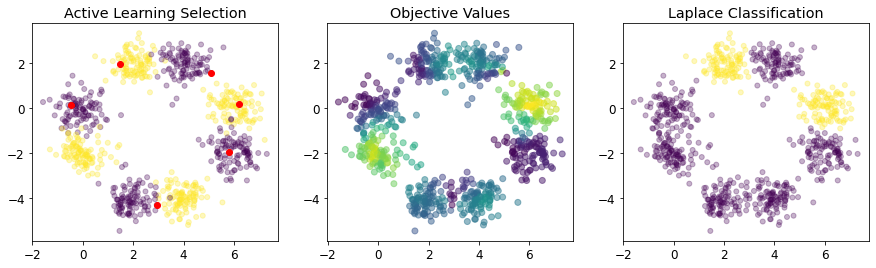

7.679859018253059 114.81613274653051
Number of Labels,Accuracy
Laplace: 6,73.678
negative diagonals: 0
negative entries: 299358


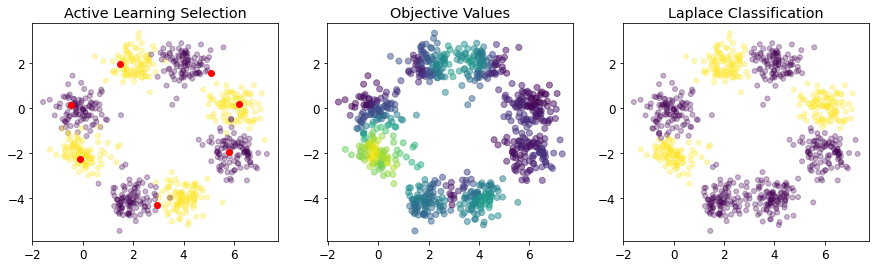

7.291402259722676 108.36096586136253
Number of Labels,Accuracy
Laplace: 7,85.246
negative diagonals: 0
negative entries: 290100


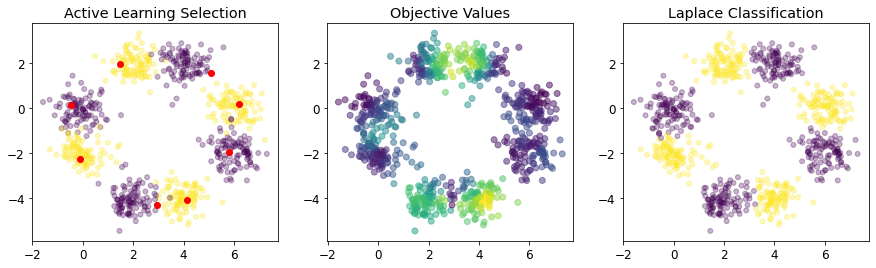

7.289486507269657 68.6875319717172
Number of Labels,Accuracy
Laplace: 8,97.096
negative diagonals: 0
negative entries: 310886


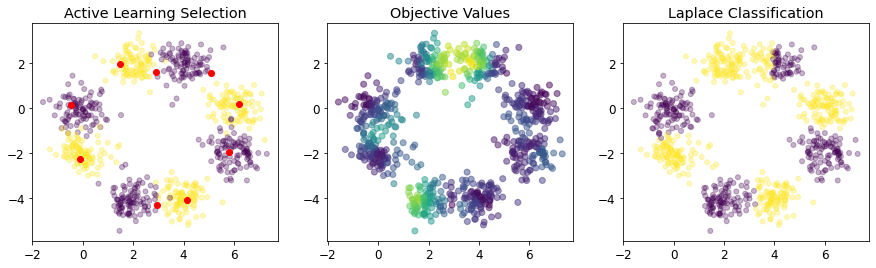

7.270416498023114 64.3499591383594
Number of Labels,Accuracy
Laplace: 9,92.162
negative diagonals: 0
negative entries: 309868


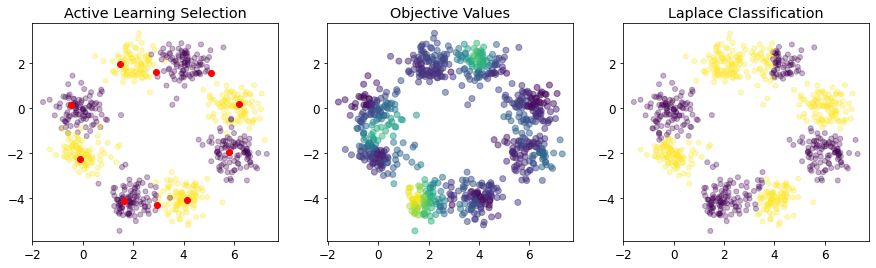

7.256619178829381 55.626417813151214
Number of Labels,Accuracy
Laplace: 10,91.013
negative diagonals: 0
negative entries: 312950


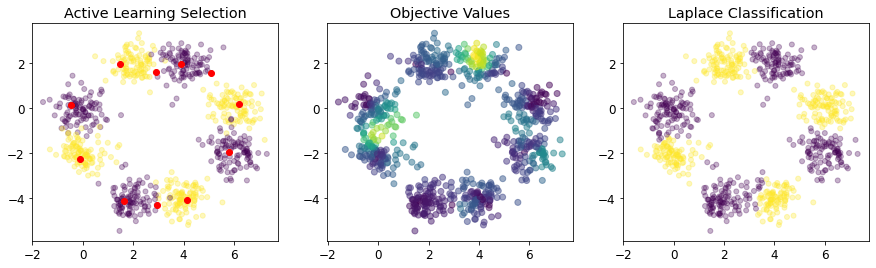

7.2569133077473165 41.417334319963324
Number of Labels,Accuracy
Laplace: 11,95.691
negative diagonals: 0
negative entries: 326568


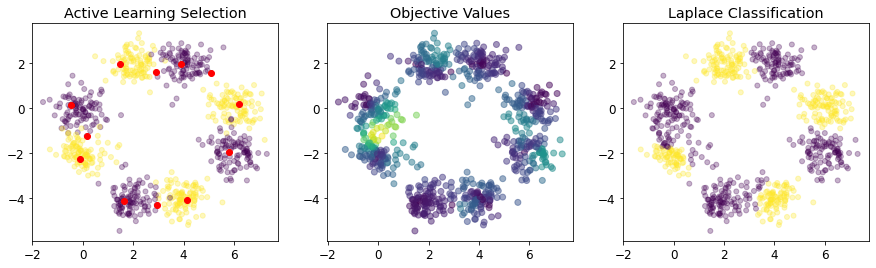

7.27774089369577 38.91885870809522
Number of Labels,Accuracy
Laplace: 12,92.766
negative diagonals: 0
negative entries: 324216


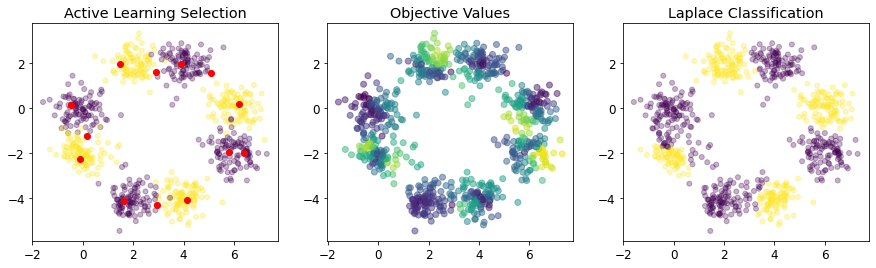

6.897766027768397 23.705749329061476
Number of Labels,Accuracy
Laplace: 13,92.757
negative diagonals: 0
negative entries: 323872


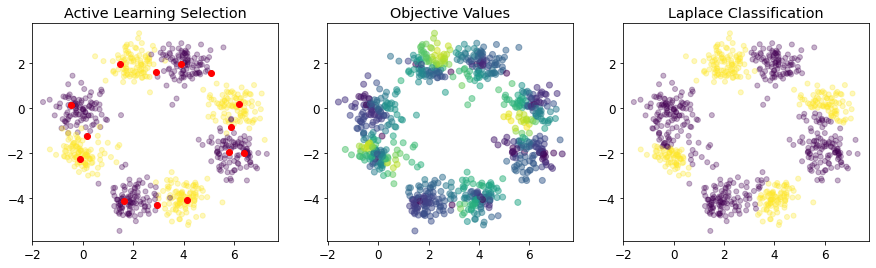

5.797882007073794 23.004370706111438
Number of Labels,Accuracy
Laplace: 14,91.094
negative diagonals: 0
negative entries: 324102


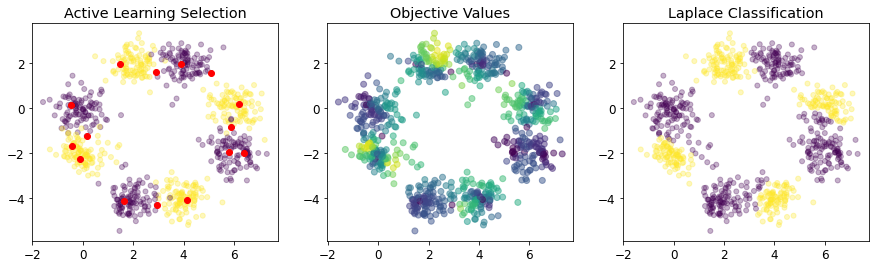

5.629583401459578 22.39098022802968
Number of Labels,Accuracy
Laplace: 15,92.866
negative diagonals: 0
negative entries: 320344


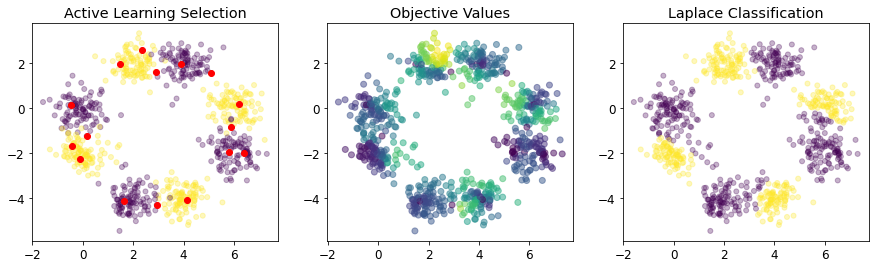

5.629729424369687 21.83365500745635
Number of Labels,Accuracy
Laplace: 16,92.857
negative diagonals: 0
negative entries: 317216


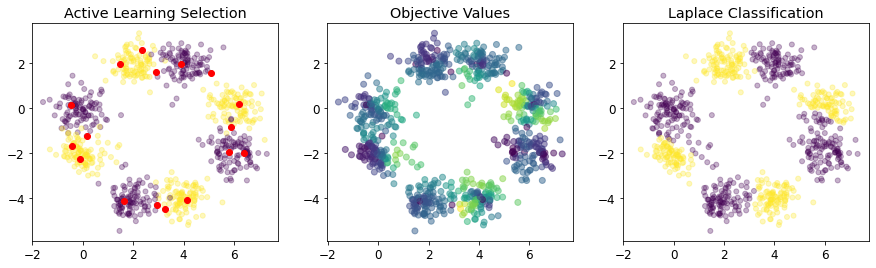

5.629930984812432 19.437978852287532
Number of Labels,Accuracy
Laplace: 17,94.125
negative diagonals: 0
negative entries: 308298


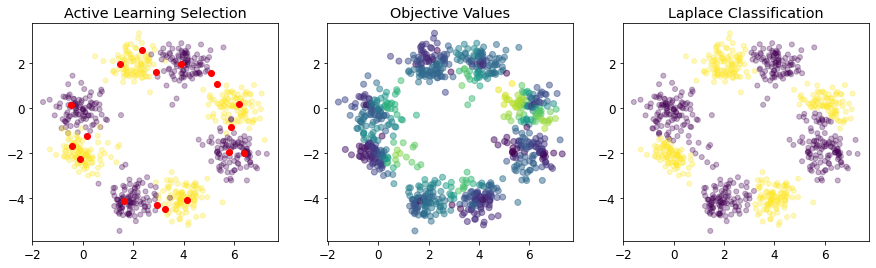

5.65066946568804 19.260797041762476
Number of Labels,Accuracy
Laplace: 18,94.246
negative diagonals: 0
negative entries: 302454


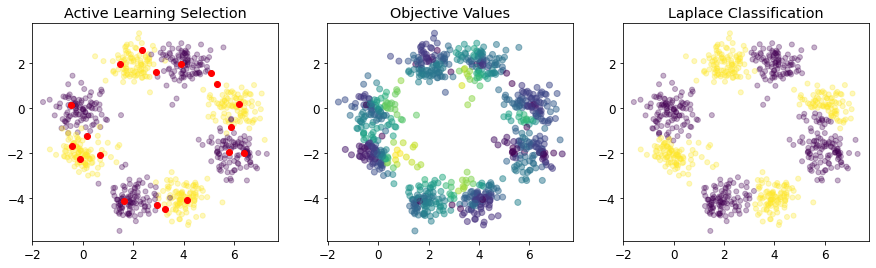

5.794293252771715 16.91899320965968
Number of Labels,Accuracy
Laplace: 19,95.134
negative diagonals: 0
negative entries: 299118


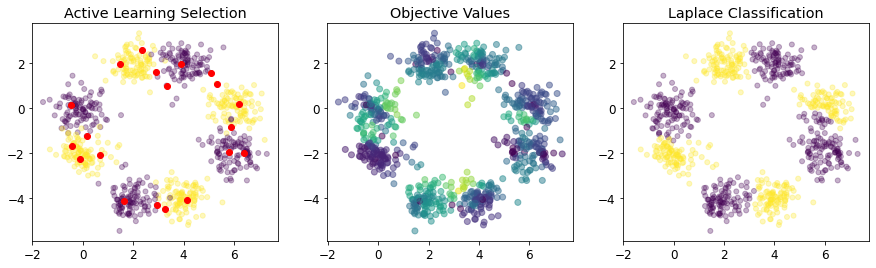

5.794801017803079 16.243554090420133
Number of Labels,Accuracy
Laplace: 20,95.256



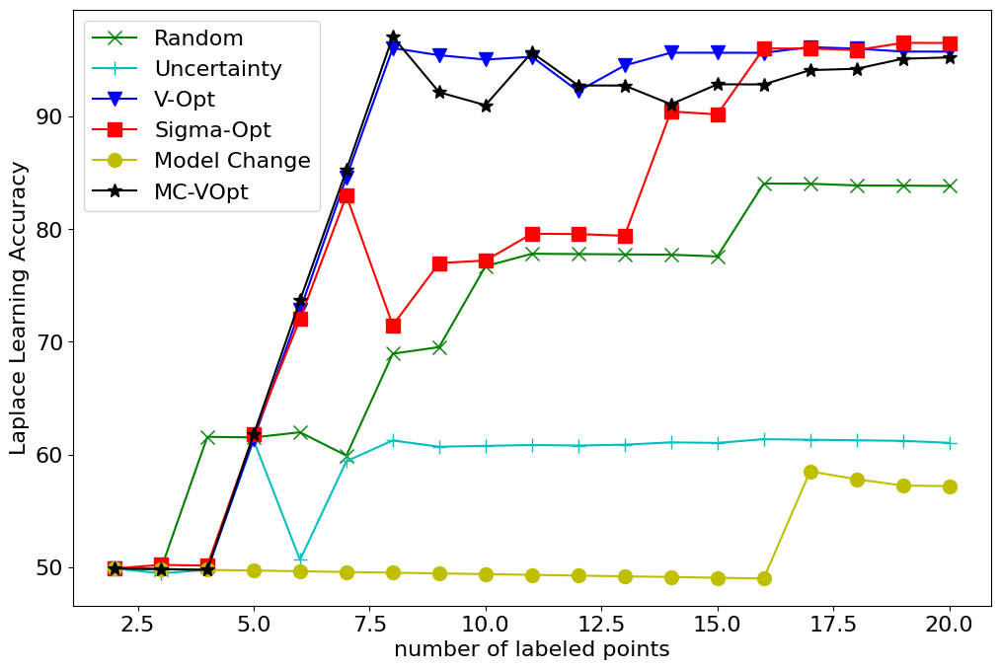

rand: 84.056 unc: 61.352 vopt: 96.169 sopt: 96.543 mc: 58.493 mc-vopt: 97.096


(array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19, 20]),
 array([49.87468672, 49.81179423, 61.55778894, 61.50943396, 61.96473552,
        59.89911728, 68.93939394, 69.53223767, 76.70886076, 77.82002535,
        77.79187817, 77.76365947, 77.73536896, 77.57961783, 84.05612245,
        84.0357599 , 83.88746803, 83.86683739, 83.84615385]),
 array([49.87468672, 49.43538269, 49.74874372, 61.25786164, 50.62972292,
        59.39470366, 61.23737374, 60.68268015, 60.75949367, 60.8365019 ,
        60.78680203, 60.86404066, 61.06870229, 61.01910828, 61.35204082,
        61.30268199, 61.25319693, 61.20358515, 61.02564103]),
 array([49.87468672, 49.81179423, 49.74874372, 61.3836478 , 72.79596977,
        84.61538462, 96.08585859, 95.44879899, 95.06329114, 95.31051965,
        92.25888325, 94.53621347, 95.67430025, 95.66878981, 95.66326531,
        96.16858238, 96.03580563, 95.77464789, 95.76923077]),
 array([49.87468672, 50.18820577, 50.12562814, 61.76100629, 72.

In [ ]:
#Sequential Active Learning
active_learning_simulation(W, labels, 1, 20, 'Laplace', 'sequential',random_state=2, plot=True)

#Sequential Active Learning Simulation for 10 Random Trials

Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,50.000
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,49.937
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,49.749
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,49.811
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,57.557
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,70.870
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,70.833
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,70.670
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,70.886
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,67.300
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,66.751
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,66.709
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,66.667
0.0 0.001272264631043257
Number of Labels,Accuracy
Laplace: 15,76.815
0.

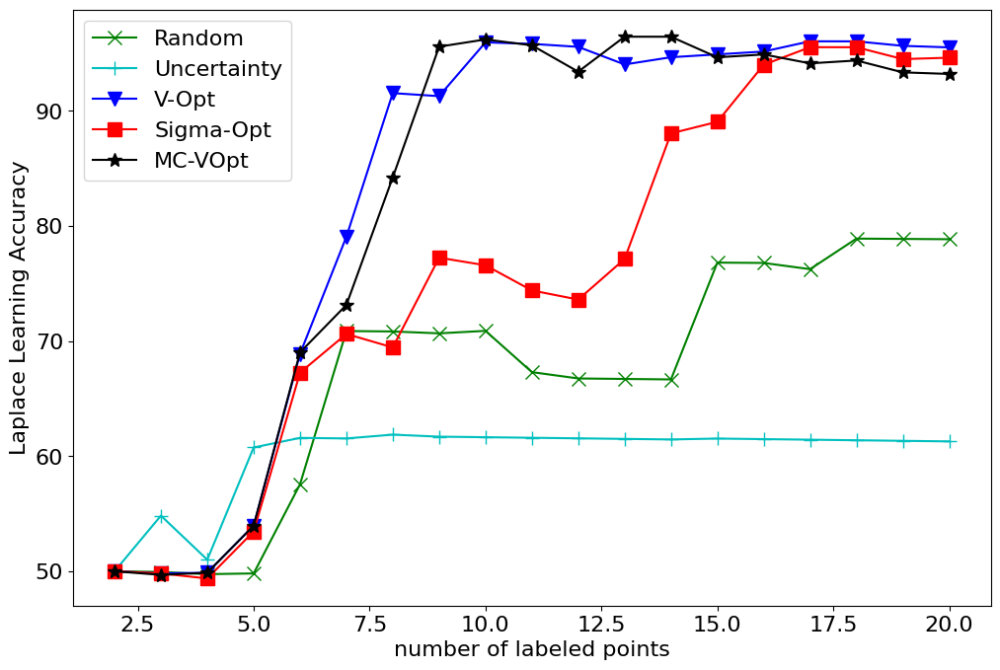

rand: 78.900 unc: 61.869 vopt: 96.041 sopt: 95.530 mc: 50.000 mc-vopt: 96.442
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,49.499
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,51.066
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,63.945
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,70.566
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,63.854
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,60.277
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,65.657
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,70.796
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,67.722
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,68.188
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,68.020
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,67.980
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,5

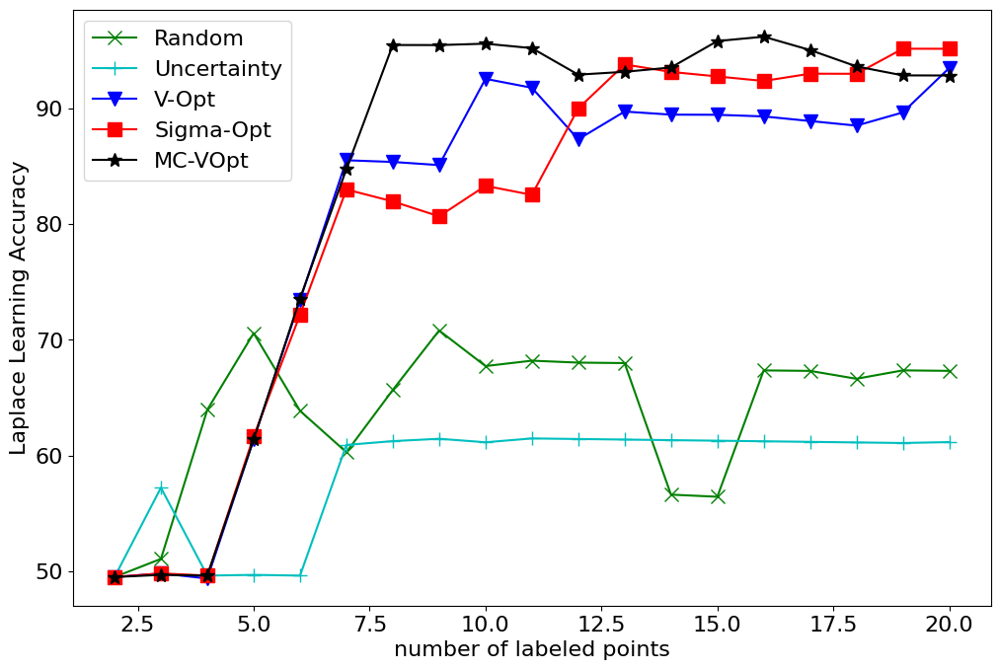

rand: 70.796 unc: 61.470 vopt: 93.462 sopt: 95.134 mc: 56.410 mc-vopt: 96.173
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,48.747
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,41.656
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,49.749
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,49.686
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,55.164
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,55.107
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,55.051
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,60.936
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,60.886
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,72.750
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,72.081
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,68.996
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

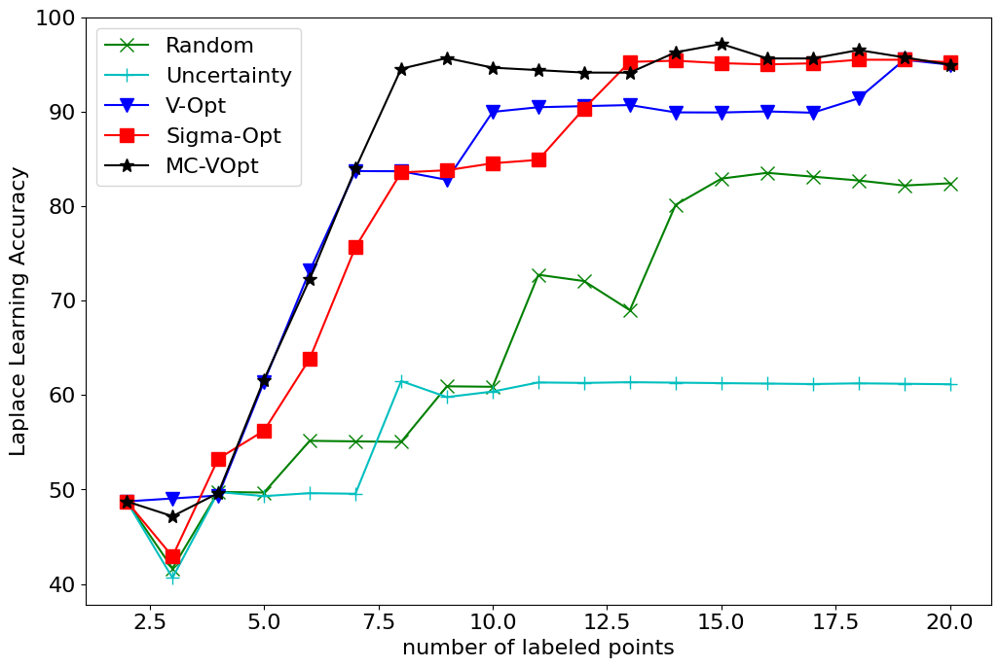

rand: 83.546 unc: 61.490 vopt: 95.519 sopt: 95.524 mc: 61.224 mc-vopt: 97.197
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,49.875
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,61.731
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,49.623
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,70.943
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,58.690
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,70.113
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,72.475
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,84.450
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,84.557
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,84.537
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,84.518
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,84.498
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,9

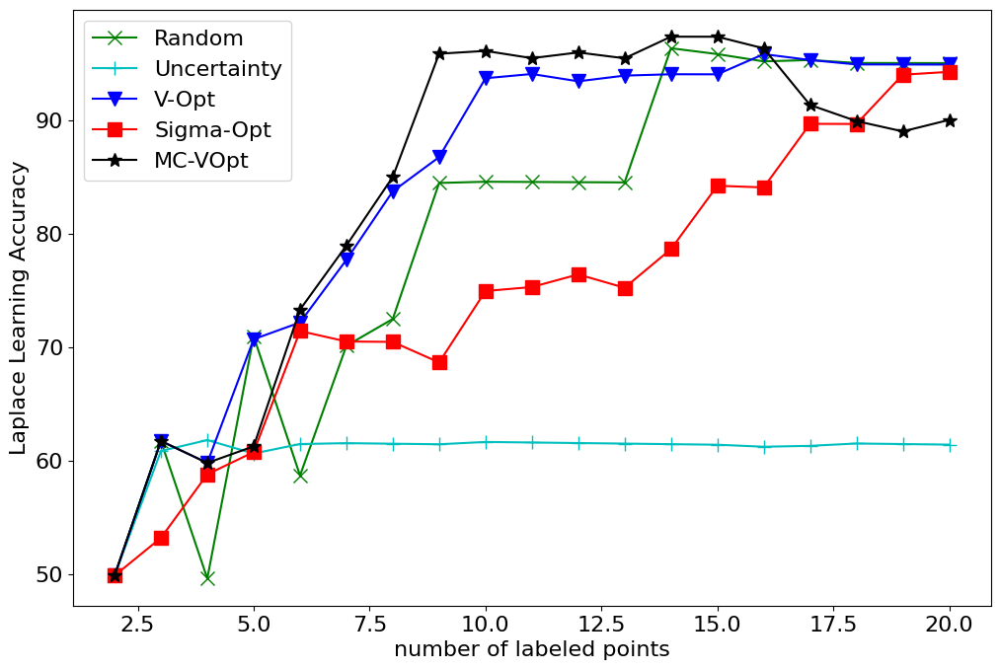

rand: 96.310 unc: 61.809 vopt: 95.791 sopt: 94.231 mc: 61.635 mc-vopt: 97.328
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,59.148
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,49.435
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,50.879
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,61.258
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,61.335
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,69.861
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,69.823
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,69.785
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,81.013
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,80.989
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,79.315
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,78.653
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

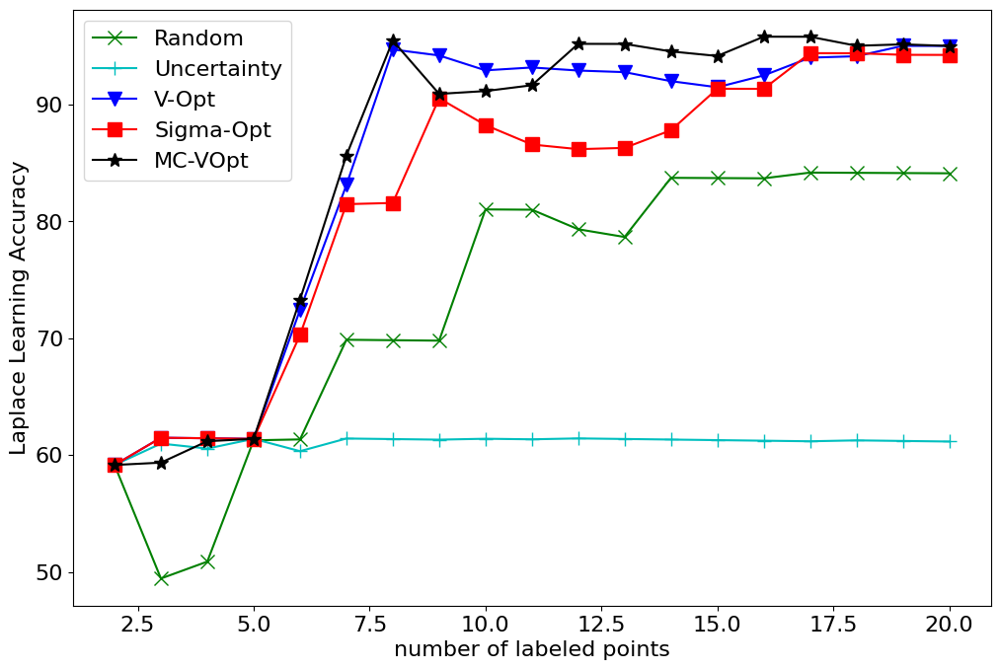

rand: 84.163 unc: 61.421 vopt: 95.006 sopt: 94.381 mc: 61.097 mc-vopt: 95.791
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,61.529
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,61.731
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,61.809
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,71.447
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,71.033
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,73.266
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,73.232
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,73.325
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,84.684
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,78.454
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,77.411
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,89.962
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

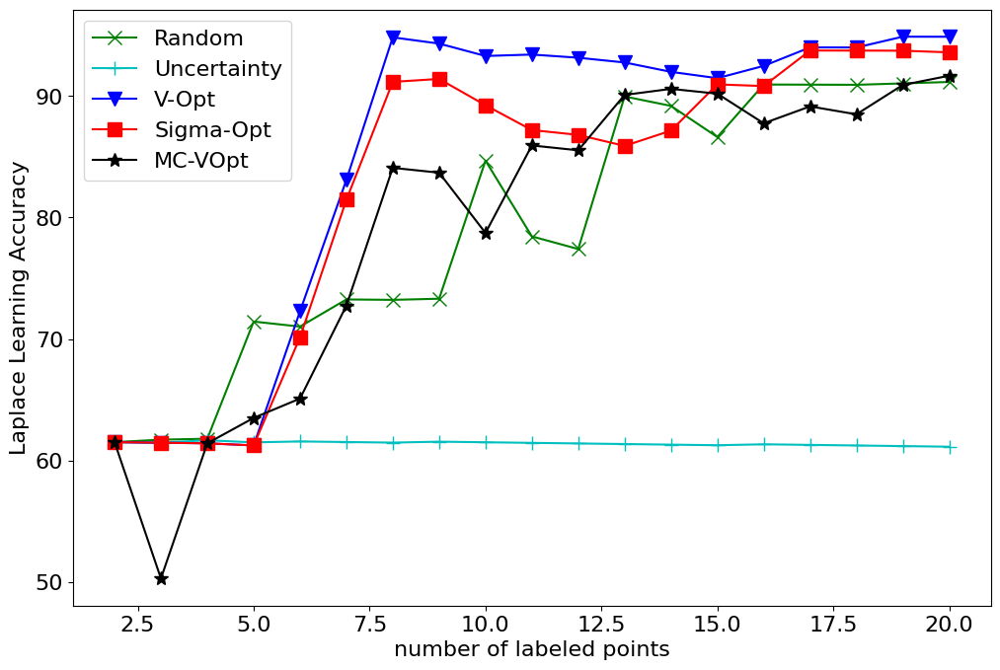

rand: 91.154 unc: 61.683 vopt: 94.878 sopt: 93.742 mc: 61.529 mc-vopt: 91.667
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,60.777
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,59.724
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,60.553
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,60.881
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,71.662
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,71.501
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,83.460
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,83.439
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,83.418
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,84.537
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,84.518
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,84.498
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

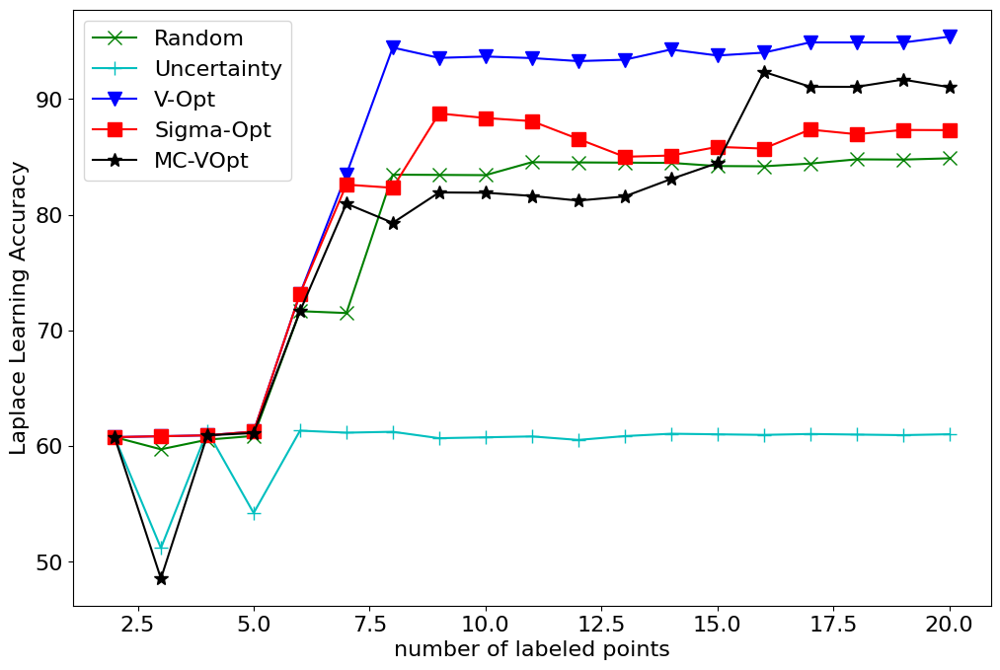

rand: 84.872 unc: 61.335 vopt: 95.385 sopt: 88.748 mc: 61.315 mc-vopt: 92.347
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,49.875
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,50.188
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,61.432
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,61.384
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,61.839
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,61.665
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,61.490
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,73.578
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,85.063
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,85.044
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,85.025
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,84.498
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

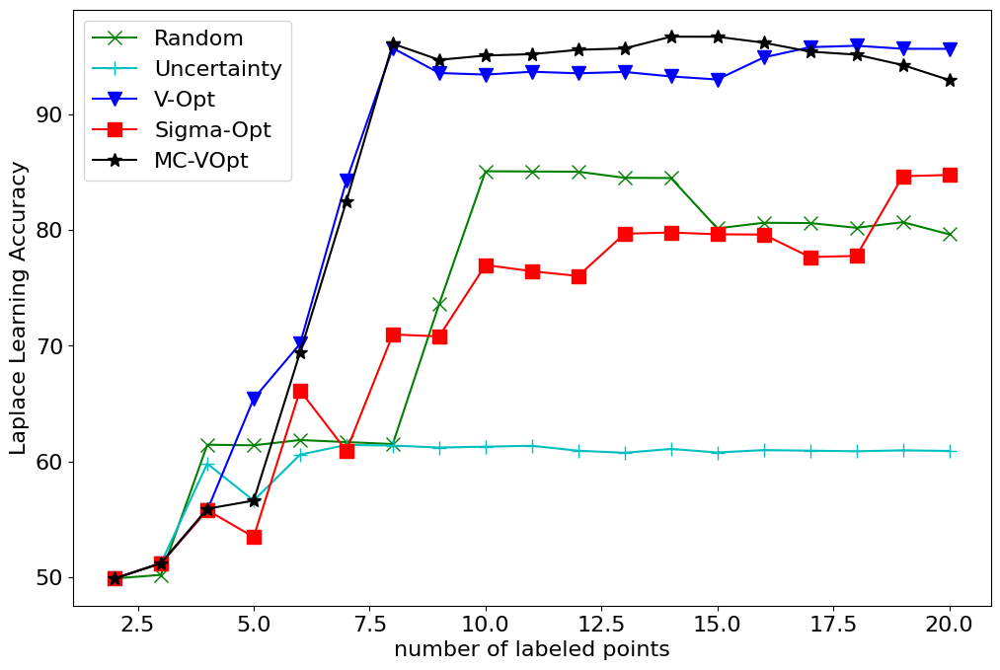

rand: 85.063 unc: 61.412 vopt: 95.908 sopt: 84.744 mc: 60.409 mc-vopt: 96.692
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,57.769
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,55.583
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,60.553
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,60.503
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,60.327
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,64.943
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,66.667
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,65.360
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,64.810
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,73.384
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,73.350
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,85.388
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,8

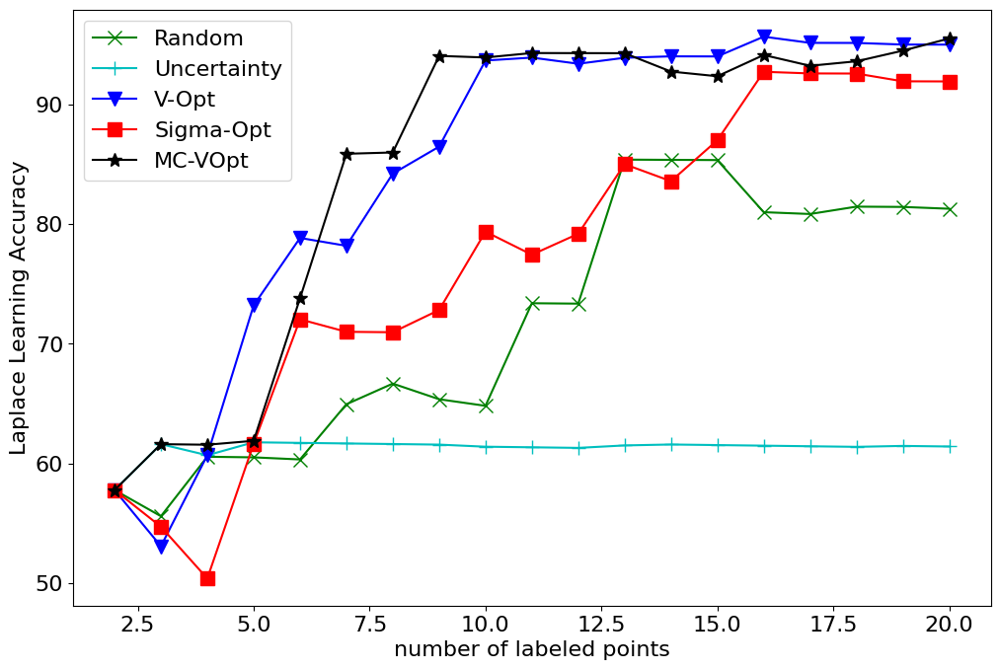

rand: 85.388 unc: 61.761 vopt: 95.663 sopt: 92.730 mc: 62.091 mc-vopt: 95.513
Random Sampling
0.250000% training data
Number of Labels,Accuracy
Laplace: 2,60.902
0.0 0.0012531328320802004
Number of Labels,Accuracy
Laplace: 3,59.348
0.0 0.0012547051442910915
Number of Labels,Accuracy
Laplace: 4,59.296
0.0 0.001256281407035176
Number of Labels,Accuracy
Laplace: 5,61.887
0.0 0.0012578616352201257
Number of Labels,Accuracy
Laplace: 6,61.839
0.0 0.0012594458438287153
Number of Labels,Accuracy
Laplace: 7,61.791
0.0 0.0012610340479192938
Number of Labels,Accuracy
Laplace: 8,61.742
0.0 0.0012626262626262627
Number of Labels,Accuracy
Laplace: 9,61.694
0.0 0.0012642225031605564
Number of Labels,Accuracy
Laplace: 10,61.646
0.0 0.0012658227848101266
Number of Labels,Accuracy
Laplace: 11,61.597
0.0 0.0012674271229404308
Number of Labels,Accuracy
Laplace: 12,73.350
0.0 0.0012690355329949238
Number of Labels,Accuracy
Laplace: 13,73.316
0.0 0.0012706480304955528
Number of Labels,Accuracy
Laplace: 14,7

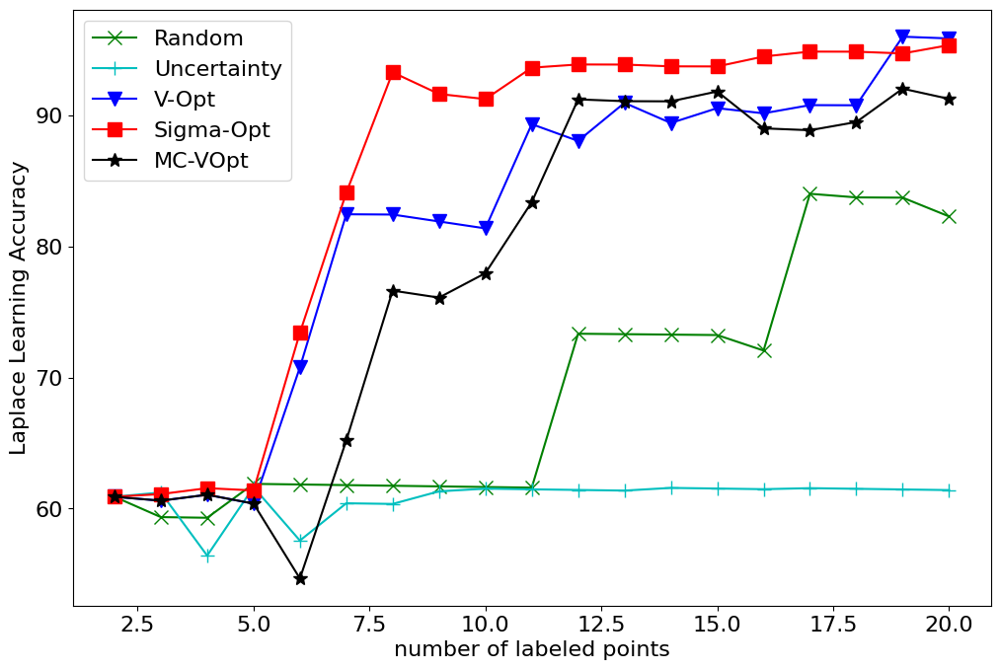

rand: 84.036 unc: 61.635 vopt: 96.031 sopt: 95.385 mc: 70.918 mc-vopt: 92.061


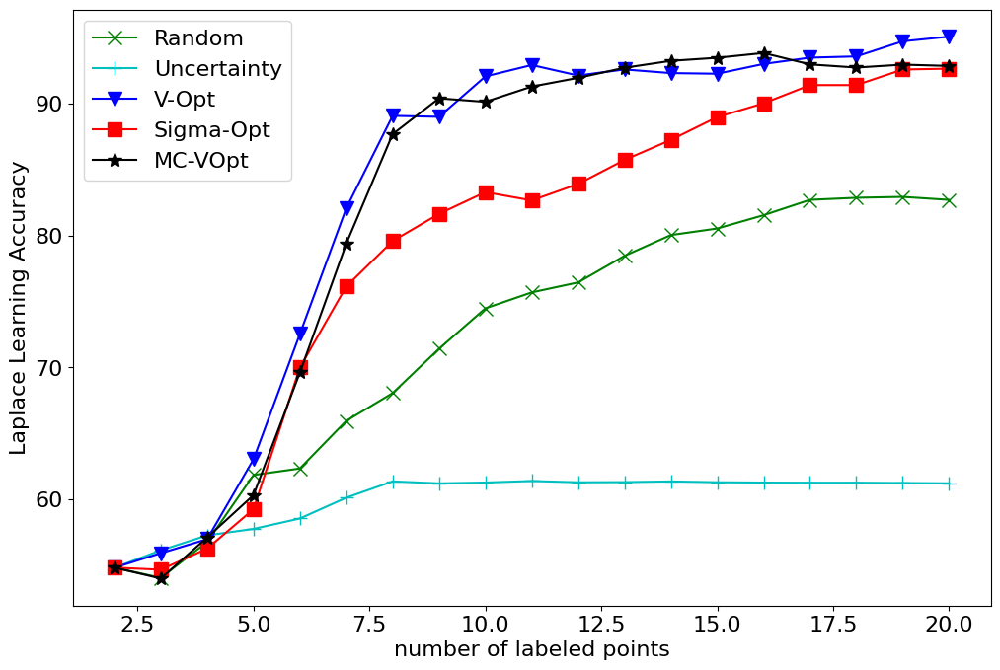

rand: 82.919 unc: 61.381 vopt: 95.064 sopt: 92.641 mc: 58.987 mc-vopt: 93.827


(array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19, 20]),
 array([54.81203008, 54.04015056, 56.75879397, 61.83647799, 62.32997481,
        65.93947037, 68.04292929, 71.40328698, 74.46835443, 75.67807351,
        76.43401015, 78.4498094 , 80.02544529, 80.52229299, 81.53061224,
        82.69476373, 82.8516624 , 82.91933419, 82.69230769]),
 array([54.81203008, 56.1229611 , 57.26130653, 57.74842767, 58.53904282,
        60.11349306, 61.3510101 , 61.20101138, 61.26582278, 61.38149556,
        61.28172589, 61.29606099, 61.34860051, 61.2866242 , 61.2627551 ,
        61.25159642, 61.25319693, 61.22919334, 61.20512821]),
 array([54.81203008, 55.90966123, 56.97236181, 63.03144654, 72.53148615,
        82.0554855 , 89.06565657, 88.988622  , 92.05063291, 92.91508238,
        92.11928934, 92.5794155 , 92.30279898, 92.25477707, 92.99744898,
        93.47381865, 93.56777494, 94.71190781, 95.06410256]),
 array([54.81203008, 54.65495609, 56.25628141, 59.24528302, 69.

In [ ]:
average_trials(10,W,labels,1,20,'Laplace','sequential')